<a href="https://colab.research.google.com/github/Iftitahyr/Klasifikasi-Penyakit-Daun-Kopi-Menggunakan-Metode-Machine-Learning-Klasik-dan-CNN/blob/main/ml_klasik.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **ML KLASIK**

#**Load Dataset**

--- Mounting Google Drive ---
Mounted at /content/drive

Split Dataset Base Path: /content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split
Training Data Path: /content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split/train
Validation Data Path: /content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split/val
Test Data Path: /content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split/test
Semua jalur folder ditemukan.

--- Discovering Class Names ---
Discovered 3 classes: ['Daun_Bercak', 'Daun_Karat', 'Daun_Sehat']

--- Loading Images and Labels ---
Images will be resized to: (128, 128)
  Loading from: /content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split/train
    Processing class: Daun_Bercak
    Processing class: Daun_Karat
    Processing class: Daun_Sehat
  Loading from: /content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split/val
    Processing class: Daun_Bercak
    Processing class: Daun_Karat
  

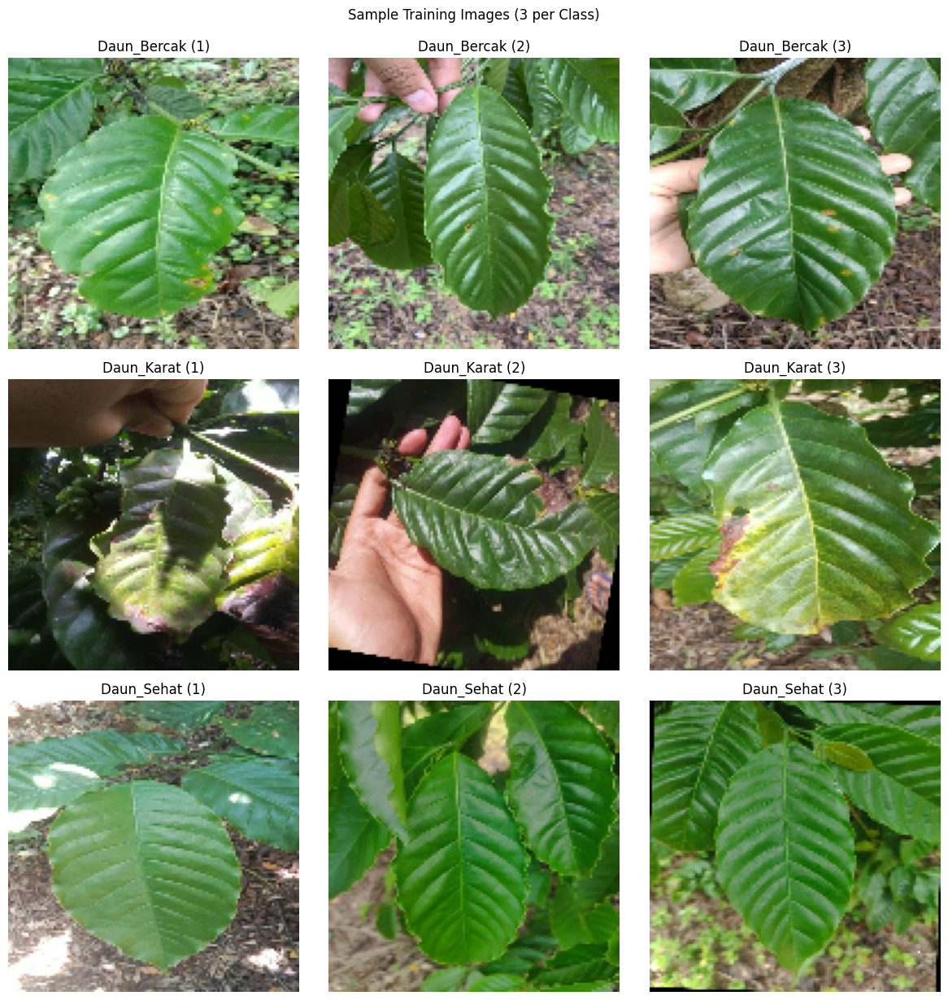

In [ ]:
# ============================================
# 1. Import Library
# ============================================
# Kita tidak membutuhkan tensorflow atau ImageDataGenerator untuk ML Klasik
# Namun, kita akan menggunakan OpenCV dan NumPy
import os
import random
import cv2 # Untuk membaca dan memproses gambar
import numpy as np # Untuk operasi array numerik
import matplotlib.pyplot as plt # Untuk visualisasi (opsional, tapi bagus untuk verifikasi)
# from sklearn.utils import class_weight # Ini bisa digunakan nanti jika ada ketidakseimbangan kelas

# ============================================
# 2. Mount Google Drive dan Set Path Dataset
# ============================================
print("--- Mounting Google Drive ---")
from google.colab import drive
drive.mount('/content/drive')

# --- PENTING: Path ini harus menunjuk ke folder *output* dari splitfolders ---
split_dataset_base_path = '/content/drive/MyDrive/semester 7/ML Teori/Dataset/dataset_coffee_split'

# Path ke masing-masing sub-folder train, val, dan test
train_dir = os.path.join(split_dataset_base_path, 'train')
val_dir = os.path.join(split_dataset_base_path, 'val')
test_dir = os.path.join(split_dataset_base_path, 'test')

print(f"\nSplit Dataset Base Path: {split_dataset_base_path}")
print(f"Training Data Path: {train_dir}")
print(f"Validation Data Path: {val_dir}")
print(f"Test Data Path: {test_dir}")

# Pastikan semua path yang diperlukan ada
if not os.path.exists(split_dataset_base_path):
    raise FileNotFoundError(f"Error: Split dataset base path '{split_dataset_base_path}' not found. Did you run the splitting script?")
if not os.path.exists(train_dir):
    raise FileNotFoundError(f"Error: Training directory '{train_dir}' not found. Check splitfolders output.")
if not os.path.exists(val_dir):
    raise FileNotFoundError(f"Error: Validation directory '{val_dir}' not found. Check splitfolders output.")
if not os.path.exists(test_dir):
    raise FileNotFoundError(f"Error: Test directory '{test_dir}' not found. Check splitfolders output.")
print("Semua jalur folder ditemukan.")

# ============================================
# 3. Dapatkan Nama Kelas dari Struktur Folder
# ============================================
print("\n--- Discovering Class Names ---")
try:
    # Nama kelas diambil dari sub-folder di dalam folder training
    initial_class_names = sorted(os.listdir(train_dir))
    # Filter hanya folder saja, bukan file lain yang mungkin ada
    initial_class_names = [name for name in initial_class_names if os.path.isdir(os.path.join(train_dir, name))]
    print(f"Discovered {len(initial_class_names)} classes: {initial_class_names}")
except Exception as e:
    raise Exception(f"Error listing classes from '{train_dir}': {e}")

# ============================================
# 4. Memuat Gambar dan Label untuk ML Klasik
# ============================================
# Kita perlu mengkonfigurasi ukuran gambar yang seragam untuk semua gambar.
# Ini penting sebelum ekstraksi fitur.

IMG_WIDTH = 128  # Anda bisa sesuaikan ukuran ini
IMG_HEIGHT = 128
IMG_SIZE = (IMG_WIDTH, IMG_HEIGHT)

print(f"\n--- Loading Images and Labels ---")
print(f"Images will be resized to: {IMG_SIZE}")

def load_data_for_ml_classic(directory_path, target_img_size):
    images = []
    labels = []

    if not os.path.exists(directory_path):
        print(f"Warning: Directory '{directory_path}' not found. Skipping.")
        return np.array([]), np.array([])

    print(f"  Loading from: {directory_path}")

    # Iterate through each class folder (e.g., coffee_healthy, coffee_red_spider_mite)
    for class_name in initial_class_names: # Gunakan initial_class_names yang sudah ditemukan
        class_folder_path = os.path.join(directory_path, class_name)
        if os.path.isdir(class_folder_path):
            print(f"    Processing class: {class_name}")
            for filename in os.listdir(class_folder_path):
                img_path = os.path.join(class_folder_path, filename)
                if os.path.isfile(img_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                    img = cv2.imread(img_path) # Baca gambar menggunakan OpenCV
                    if img is not None:
                        img = cv2.resize(img, target_img_size) # Resize gambar
                        images.append(img)
                        labels.append(class_name)
                    else:
                        print(f"      Warning: Could not load image: {img_path}")
                # else:
                #     print(f"      Skipping non-image file: {img_path}")

    return np.array(images), np.array(labels)

# Muat data untuk setiap split
X_train, y_train_str = load_data_for_ml_classic(train_dir, IMG_SIZE)
X_val, y_val_str = load_data_for_ml_classic(val_dir, IMG_SIZE)
X_test, y_test_str = load_data_for_ml_classic(test_dir, IMG_SIZE)

print("\n--- Data Loading Summary ---")
print(f"Training Set: {len(X_train)} images, labels {len(y_train_str)}")
if len(X_train) > 0:
    print(f"  Example image shape: {X_train[0].shape}")
    print(f"  Example label: {y_train_str[0]}")

print(f"Validation Set: {len(X_val)} images, labels {len(y_val_str)}")
if len(X_val) > 0:
    print(f"  Example image shape: {X_val[0].shape}")
    print(f"  Example label: {y_val_str[0]}")

print(f"Test Set: {len(X_test)} images, labels {len(y_test_str)}")
if len(X_test) > 0:
    print(f"  Example image shape: {X_test[0].shape}")
    print(f"  Example label: {y_test_str[0]}")

print("\n--- Variables available after loading ---")
print("  X_train, y_train_str")
print("  X_val, y_val_str")
print("  X_test, y_test_str")
print("  initial_class_names")
print("  IMG_SIZE")

# ============================================
# 5. (Opsional) Visualisasi Beberapa Gambar (MODIFIED)
# ============================================
num_samples_per_class = 3 # Jumlah gambar yang akan ditampilkan per kelas

if len(X_train) > 0 and len(initial_class_names) > 0:
    print(f"\n--- Visualisasi {num_samples_per_class} Contoh Gambar per Kelas dari Training Set ---")

    # Hitung jumlah kelas dan buat subplot grid
    num_classes = len(initial_class_names)
    # Atur ukuran figure agar sesuai dengan jumlah kelas dan sampel per kelas
    fig, axes = plt.subplots(num_classes, num_samples_per_class, figsize=(num_samples_per_class * 4, num_classes * 4))

    # Pastikan 'axes' adalah array 2D untuk konsistensi indexing, bahkan jika hanya 1 kelas
    if num_classes == 1:
        axes = np.expand_dims(axes, axis=0)
    elif num_samples_per_class == 1: # Jika hanya 1 sampel, axes juga bisa 1D
        axes = np.expand_dims(axes, axis=1)


    for i, class_name in enumerate(initial_class_names):
        # Temukan indeks gambar yang termasuk dalam kelas ini
        class_indices = np.where(y_train_str == class_name)[0]

        # Acak dan pilih sejumlah gambar dari kelas ini (maksimal num_samples_per_class)
        # Ambil sejumlah kecil, atau semua jika kurang dari num_samples_per_class
        selected_indices_in_class = random.sample(list(class_indices), min(len(class_indices), num_samples_per_class))

        for j, img_idx_in_X_train in enumerate(selected_indices_in_class):
            ax = axes[i, j]
            # OpenCV membaca BGR, Matplotlib menampilkan RGB
            ax.imshow(cv2.cvtColor(X_train[img_idx_in_X_train], cv2.COLOR_BGR2RGB))
            ax.set_title(f"{class_name} ({j+1})")
            ax.axis('off')

        # Jika ada kurang dari num_samples_per_class gambar, kosongkan subplot sisanya di baris ini
        for k in range(len(selected_indices_in_class), num_samples_per_class):
            ax = axes[i, k]
            ax.axis('off') # Sembunyikan subplot kosong

    plt.tight_layout()
    plt.suptitle(f'Sample Training Images ({num_samples_per_class} per Class)', y=1.02) # y adalah posisi judul utama
    plt.show()
else:
    print("Tidak ada data training atau kelas yang ditemukan untuk visualisasi.")

#**EDA**

--- Memulai Exploratory Data Analysis (EDA) ---

[2.1] Ringkasan Ukuran Dataset:
  - Training Set: 3600 gambar
  - Validation Set: 450 gambar
  - Test Set: 450 gambar

[2.2] Bentuk (Shape) Gambar Contoh:
  - Ukuran target gambar (setelah resize): (128, 128)
  - Contoh gambar training (shape): (128, 128, 3)
  - Tipe data gambar training: uint8
  - Range nilai piksel gambar training: 0 - 255

[3.1] Distribusi Kelas per Split:

--- Jumlah Gambar per Kelas per Split ---
Label       Daun_Bercak  Daun_Karat  Daun_Sehat
Split                                          
Test                150         150         150
Train              1200        1200        1200
Validation          150         150         150


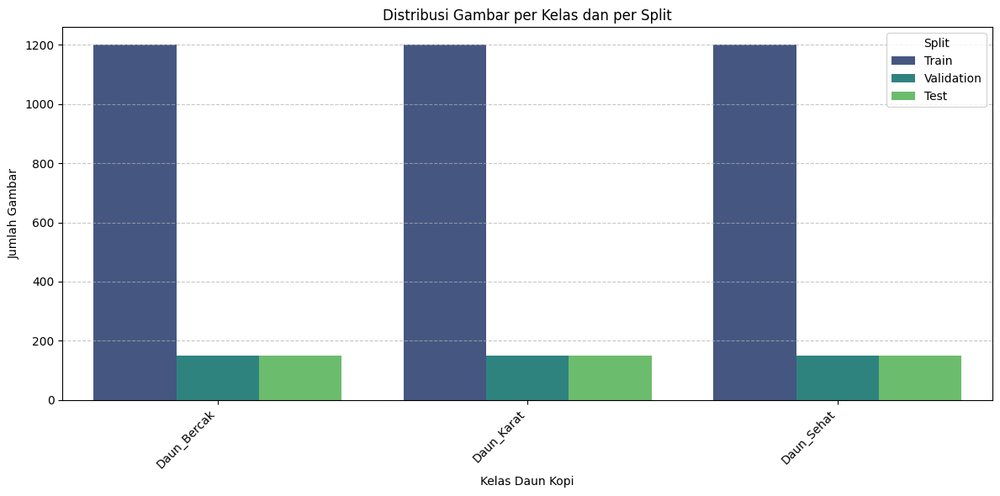

/tmp/ipython-input-2014349996.py:76: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_eda, x='Label', palette='viridis', order=all_unique_class_names)


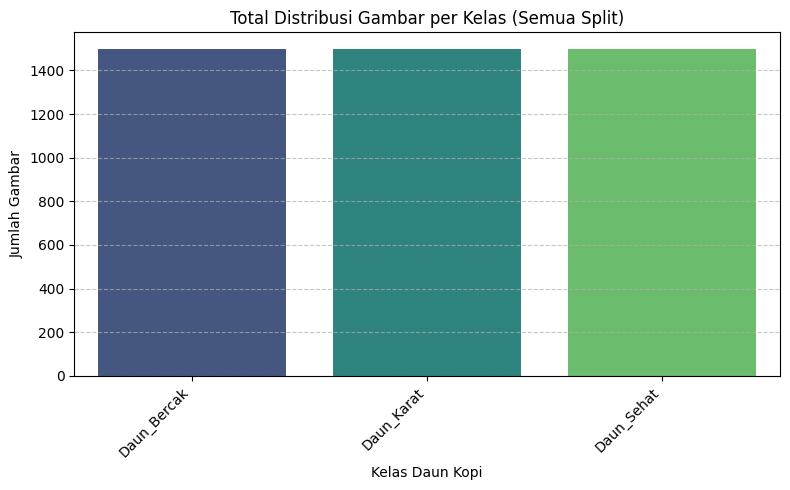


--- Analisis Ketidakseimbangan Kelas (Total) ---
Label
Daun_Bercak    1500
Daun_Karat     1500
Daun_Sehat     1500
Name: count, dtype: int64

Dataset terlihat cukup seimbang.

[4.1] Visualisasi Contoh Gambar dari Setiap Kelas:


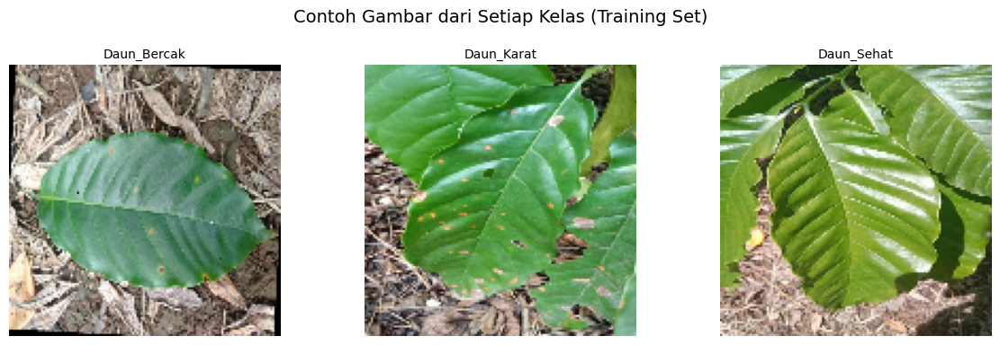


--- EDA Selesai ---
Wawasan yang didapat dari EDA akan sangat berguna untuk langkah selanjutnya (Ekstraksi Fitur dan Model).


In [ ]:
# ============================================
# 1. Import Library Tambahan untuk EDA
# ============================================
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter # Untuk menghitung frekuensi item
from sklearn.preprocessing import LabelEncoder # Jika belum diimpor sebelumnya

# Asumsi variabel-variabel berikut sudah tersedia dari langkah 'load dataset':
# X_train, y_train_str
# X_val, y_val_str
# X_test, y_test_str
# initial_class_names (list of class names, e.g., ['coffee_healthy', 'coffee_red_spider_mite', 'coffee_rust'])
# IMG_SIZE (tuple, e.g., (128, 128))

print("--- Memulai Exploratory Data Analysis (EDA) ---")

# ============================================
# 2. Ringkasan Ukuran Dataset dan Bentuk Gambar
# ============================================
print("\n[2.1] Ringkasan Ukuran Dataset:")
print(f"  - Training Set: {len(X_train)} gambar")
print(f"  - Validation Set: {len(X_val)} gambar")
print(f"  - Test Set: {len(X_test)} gambar")

if len(X_train) > 0:
    print(f"\n[2.2] Bentuk (Shape) Gambar Contoh:")
    print(f"  - Ukuran target gambar (setelah resize): {IMG_SIZE}")
    print(f"  - Contoh gambar training (shape): {X_train[0].shape}") # (tinggi, lebar, kanal_warna)
    print(f"  - Tipe data gambar training: {X_train[0].dtype}") # Umumnya uint8 (0-255)
    print(f"  - Range nilai piksel gambar training: {X_train[0].min()} - {X_train[0].max()}") # Seharusnya 0-255
else:
    print("\n[2.1] Tidak ada gambar di training set. Pemuatan data mungkin gagal.")


# ============================================
# 3. Distribusi Kelas
# ============================================
print("\n[3.1] Distribusi Kelas per Split:")

# Menggabungkan label dari semua split untuk mendapatkan semua kelas unik
all_labels_str = np.concatenate([y_train_str, y_val_str, y_test_str])
all_unique_class_names = sorted(list(set(all_labels_str)))

# Menggunakan LabelEncoder untuk mendapatkan representasi numerik jika belum ada
# atau untuk memastikan urutan konsisten di plot
le = LabelEncoder()
le.fit(all_unique_class_names) # Fit pada semua label unik

# Buat DataFrame untuk mempermudah visualisasi
df_eda_train = pd.DataFrame({'Label': y_train_str, 'Split': 'Train'})
df_eda_val = pd.DataFrame({'Label': y_val_str, 'Split': 'Validation'})
df_eda_test = pd.DataFrame({'Label': y_test_str, 'Split': 'Test'})

df_eda = pd.concat([df_eda_train, df_eda_val, df_eda_test])

# Hitung frekuensi per kelas per split
class_distribution = df_eda.groupby(['Split', 'Label']).size().unstack(fill_value=0)
print("\n--- Jumlah Gambar per Kelas per Split ---")
print(class_distribution)

# Visualisasi distribusi kelas
plt.figure(figsize=(12, 6))
sns.countplot(data=df_eda, x='Label', hue='Split', palette='viridis', order=all_unique_class_names)
plt.title('Distribusi Gambar per Kelas dan per Split')
plt.xlabel('Kelas Daun Kopi')
plt.ylabel('Jumlah Gambar')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Visualisasi total distribusi kelas (gabungan semua split)
plt.figure(figsize=(8, 5))
sns.countplot(data=df_eda, x='Label', palette='viridis', order=all_unique_class_names)
plt.title('Total Distribusi Gambar per Kelas (Semua Split)')
plt.xlabel('Kelas Daun Kopi')
plt.ylabel('Jumlah Gambar')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Analisis ketidakseimbangan kelas
total_counts = df_eda['Label'].value_counts()
print("\n--- Analisis Ketidakseimbangan Kelas (Total) ---")
print(total_counts)
if total_counts.min() / total_counts.max() < 0.5: # Ambang batas bisa disesuaikan
    print("\n❗ Peringatan: Dataset mungkin tidak seimbang! Pertimbangkan teknik penanganan ketidakseimbangan (mis. class_weight, oversampling, undersampling) saat training model.")
else:
    print("\nDataset terlihat cukup seimbang.")


# ============================================
# 4. Visualisasi Contoh Gambar per Kelas
# ============================================
print("\n[4.1] Visualisasi Contoh Gambar dari Setiap Kelas:")

# Ambil satu contoh gambar per kelas dari training set
sample_images_per_class = {}
for class_name in initial_class_names:
    # Cari index gambar pertama dari kelas tersebut di training set
    idx = np.where(y_train_str == class_name)[0]
    if len(idx) > 0:
        sample_images_per_class[class_name] = X_train[idx[0]]

if not sample_images_per_class:
    print("Tidak ada contoh gambar yang ditemukan per kelas di training set untuk visualisasi.")
else:
    num_classes = len(sample_images_per_class)
    fig, axes = plt.subplots(1, num_classes, figsize=(num_classes * 4, 4))

    if num_classes == 1: # Handle case of single class
        axes = [axes]

    for i, (class_name, img) in enumerate(sample_images_per_class.items()):
        axes[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)) # Convert BGR to RGB for matplotlib
        axes[i].set_title(class_name, fontsize=10)
        axes[i].axis('off')

    plt.suptitle('Contoh Gambar dari Setiap Kelas (Training Set)', fontsize=14)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

print("\n--- EDA Selesai ---")
print("Wawasan yang didapat dari EDA akan sangat berguna untuk langkah selanjutnya (Ekstraksi Fitur dan Model).")

#**Preprocessing**

--- Memulai Preprocessing Gambar (Normalisasi & Augmentasi untuk Semua Kelas) ---

[2.1] Normalisasi piksel gambar ke rentang [0, 1] untuk semua split...
  X_train[0] (sebelum normalisasi) dtype: uint8, min: 0, max: 255
  X_train_normalized[0] (setelah normalisasi) dtype: float32, min: 0.0, max: 1.0
  Normalisasi piksel selesai.

[3.1] Memulai Augmentasi Data untuk SEMUA KELAS...
  Faktor augmentasi: 2x per gambar

  Distribusi kelas sebelum augmentasi:
    - Daun_Bercak: 1200 gambar
    - Daun_Karat: 1200 gambar
    - Daun_Sehat: 1200 gambar

  Mengambil contoh gambar 'Daun_Bercak' (indeks: 0) untuk visualisasi augmentasi.

  Mengaugmentasi 3600 gambar dari semua kelas...
    Processing image 100/3600 for augmentation...
    Processing image 200/3600 for augmentation...
    Processing image 300/3600 for augmentation...
    Processing image 400/3600 for augmentation...
    Processing image 500/3600 for augmentation...
    Processing image 600/3600 for augmentation...
    Processing ima

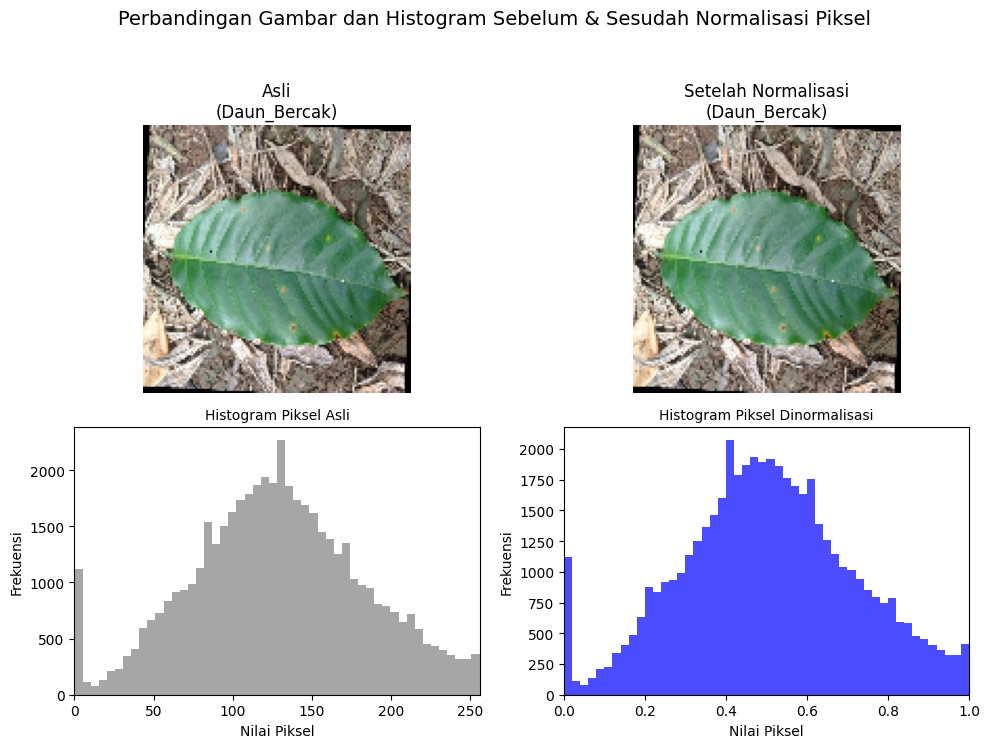

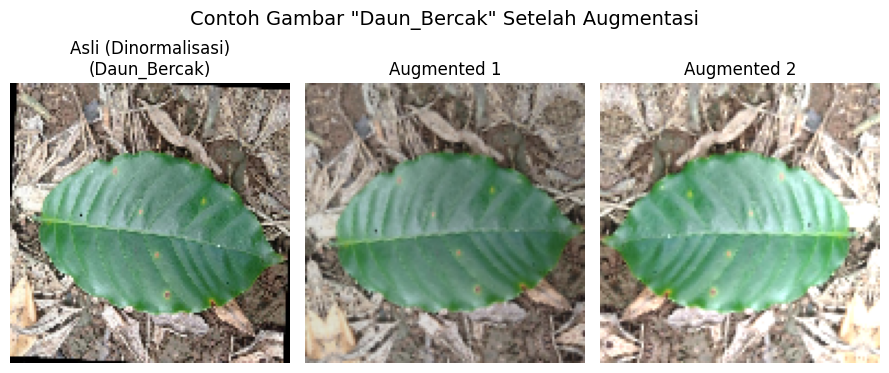


[4.3] Visualisasi Contoh Gambar per Kelas (Setelah Preprocessing):


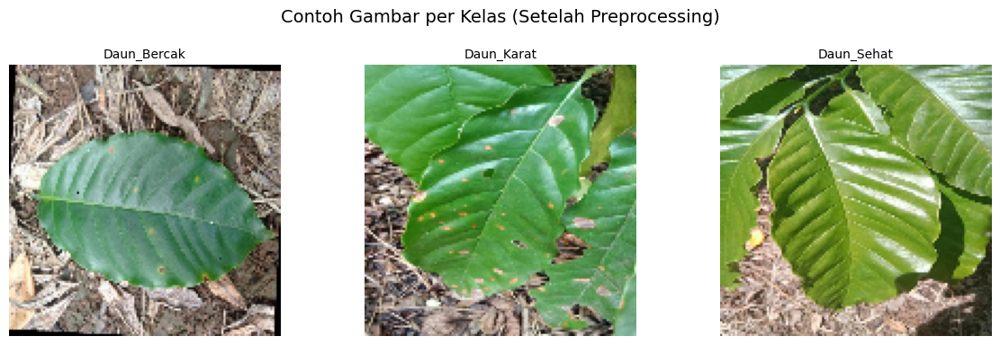

/tmp/ipython-input-497087565.py:263: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df_augmented_labels, x='Label', palette='viridis',


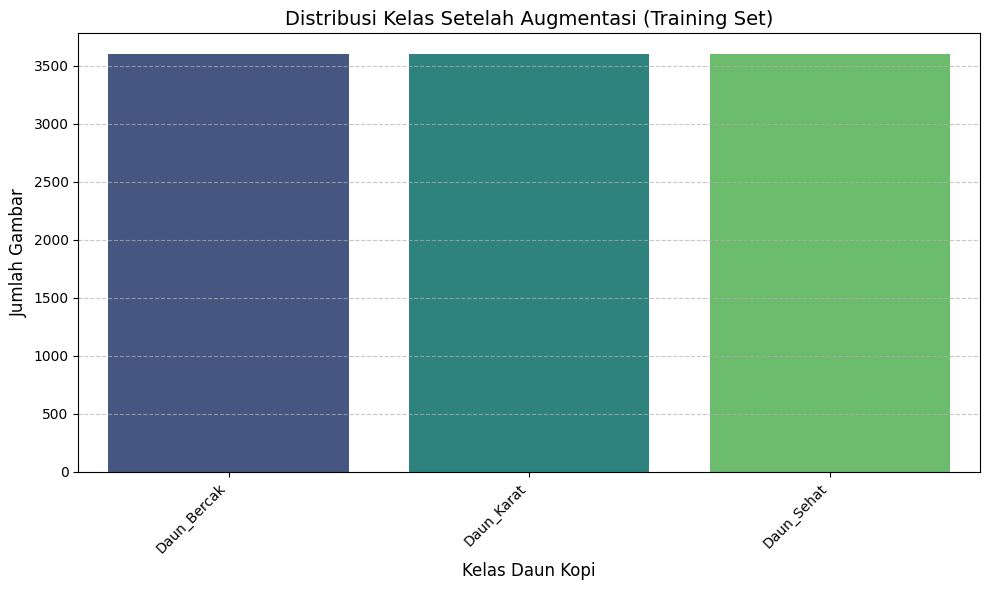


  Jumlah Gambar per Kelas Setelah Augmentasi:
Counter({np.str_('Daun_Bercak'): 3600, np.str_('Daun_Karat'): 3600, np.str_('Daun_Sehat'): 3600})

--- Ringkasan Akhir Setelah Preprocessing Gambar ---
Final Training Set (X_train_processed): 10800 images
Final Validation Set (X_val_processed): 450 images
Final Test Set (X_test_processed): 450 images

Contoh gambar training setelah preprocessing (shape): (128, 128, 3)
Tipe data gambar training setelah preprocessing: float32
Range nilai piksel gambar training setelah preprocessing: 0.0 - 1.0

--- Preprocessing Gambar Selesai ---
Gambar sekarang sudah dinormalisasi dan diaugmentasi untuk semua kelas. Siap untuk Ekstraksi Fitur.


In [ ]:
#**Preprocessing**

# ============================================
# 1. Import Library
# ============================================
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random
from collections import Counter
import pandas as pd

# Asumsi variabel-variabel berikut sudah tersedia dari langkah 'load dataset':
# X_train, y_train_str
# X_val, y_val_str
# X_test, y_test_str
# IMG_SIZE (tuple, e.g., (128, 128))
# initial_class_names (list of class names)

print("--- Memulai Preprocessing Gambar (Normalisasi & Augmentasi untuk Semua Kelas) ---")

# ============================================
# 2. Normalisasi Piksel (Wajib)
# ============================================
print("\n[2.1] Normalisasi piksel gambar ke rentang [0, 1] untuk semua split...")

original_sample_img = None
original_sample_label = None

if len(X_train) > 0:
    original_sample_img = X_train[0].copy()
    original_sample_label = y_train_str[0]
    print(f"  X_train[0] (sebelum normalisasi) dtype: {X_train[0].dtype}, min: {X_train[0].min()}, max: {X_train[0].max()}")

X_train_normalized = X_train.astype('float32') / 255.0
X_val_normalized = X_val.astype('float32') / 255.0
X_test_normalized = X_test.astype('float32') / 255.0

if len(X_train_normalized) > 0:
    print(f"  X_train_normalized[0] (setelah normalisasi) dtype: {X_train_normalized[0].dtype}, min: {X_train_normalized[0].min()}, max: {X_train_normalized[0].max()}")

print("  Normalisasi piksel selesai.")

# --- DEKLARASI VARIABEL UNTUK MENYIMPAN DATA PROSES ---
X_train_processed = X_train_normalized
y_train_str_processed = y_train_str
X_val_processed = X_val_normalized
y_val_str_processed = y_val_str
X_test_processed = X_test_normalized
y_test_str_processed = y_test_str


# ============================================
# 3. Augmentasi Data (Untuk Semua Kelas)
# ============================================
PERFORM_AUGMENTATION = True  # Set True untuk mengaktifkan augmentasi
AUGMENTATION_FACTOR = 2  # Jumlah gambar augmented per gambar asli (misal: 2x berarti setiap gambar diaugmentasi 2 kali)

# Variabel untuk menyimpan contoh gambar augmented untuk visualisasi
sample_img_for_aug = None
sample_label_for_aug = None
visual_augmented_samples = []

if PERFORM_AUGMENTATION:
    print(f"\n[3.1] Memulai Augmentasi Data untuk SEMUA KELAS...")
    print(f"  Faktor augmentasi: {AUGMENTATION_FACTOR}x per gambar")

    # Inisialisasi daftar dengan semua gambar asli yang sudah dinormalisasi
    X_train_processed_list = list(X_train_normalized)
    y_train_str_processed_list = list(y_train_str)

    original_train_count = len(X_train_normalized)

    if original_train_count == 0:
        print("  Tidak ada gambar di training set untuk di augmentasi.")
    else:
        # Hitung distribusi kelas asli
        class_counts = Counter(y_train_str)
        print(f"\n  Distribusi kelas sebelum augmentasi:")
        for cls, count in class_counts.items():
            print(f"    - {cls}: {count} gambar")

        # Ambil satu contoh gambar untuk visualisasi (dari kelas pertama)
        first_class = initial_class_names[0]
        sample_indices = np.where(y_train_str == first_class)[0]
        if len(sample_indices) > 0:
            sample_idx = sample_indices[0]
            sample_img_for_aug = X_train_normalized[sample_idx]
            sample_label_for_aug = y_train_str[sample_idx]
            print(f"\n  Mengambil contoh gambar '{sample_label_for_aug}' (indeks: {sample_idx}) untuk visualisasi augmentasi.")

        # Augmentasi untuk SEMUA gambar dari SEMUA kelas
        print(f"\n  Mengaugmentasi {len(X_train_normalized)} gambar dari semua kelas...")

        augmentation_count = 0
        for i, (img, label) in enumerate(zip(X_train_normalized, y_train_str)):
            if (i + 1) % 100 == 0:
                print(f"    Processing image {i+1}/{len(X_train_normalized)} for augmentation...")

            # Augmentasi sebanyak AUGMENTATION_FACTOR kali
            for k in range(AUGMENTATION_FACTOR):
                augmented_img = img.copy()

                # === Operasi Augmentasi ===

                # 1. Rotasi Random (-15 hingga +15 derajat)
                angle = random.uniform(-15, 15)
                M = cv2.getRotationMatrix2D((IMG_SIZE[0] / 2, IMG_SIZE[1] / 2), angle, 1)
                augmented_img = cv2.warpAffine(augmented_img, M, IMG_SIZE, borderMode=cv2.BORDER_REFLECT_101)

                # 2. Flip Horizontal (probabilitas 50%)
                if random.random() > 0.5:
                    augmented_img = cv2.flip(augmented_img, 1)

                # 3. Flip Vertikal (probabilitas 30%)
                if random.random() > 0.7:
                    augmented_img = cv2.flip(augmented_img, 0)

                # 4. Penyesuaian Brightness/Contrast
                img_uint8 = (augmented_img * 255).astype(np.uint8)
                alpha = random.uniform(0.8, 1.2)  # Kontras
                beta = random.uniform(-10, 10)    # Brightness
                augmented_img = cv2.convertScaleAbs(img_uint8, alpha=alpha, beta=beta).astype('float32') / 255.0
                augmented_img = np.clip(augmented_img, 0.0, 1.0)

                # 5. Zoom In/Out (probabilitas 40%)
                if random.random() > 0.6:
                    zoom_factor = random.uniform(0.9, 1.1)
                    h, w = augmented_img.shape[:2]
                    new_h, new_w = int(h * zoom_factor), int(w * zoom_factor)

                    if zoom_factor > 1:  # Zoom in
                        resized = cv2.resize(augmented_img, (new_w, new_h))
                        start_h = (new_h - h) // 2
                        start_w = (new_w - w) // 2
                        augmented_img = resized[start_h:start_h+h, start_w:start_w+w]
                    else:  # Zoom out
                        resized = cv2.resize(augmented_img, (new_w, new_h))
                        augmented_img = np.zeros_like(augmented_img)
                        start_h = (h - new_h) // 2
                        start_w = (w - new_w) // 2
                        augmented_img[start_h:start_h+new_h, start_w:start_w+new_w] = resized

                # Tambahkan gambar augmented ke daftar
                X_train_processed_list.append(augmented_img)
                y_train_str_processed_list.append(label)
                augmentation_count += 1

                # Simpan contoh visual augmentasi (maksimal 5 contoh)
                if sample_img_for_aug is not None and i == sample_idx and len(visual_augmented_samples) < 5:
                    visual_augmented_samples.append(augmented_img)

        # Konversi daftar kembali ke NumPy array
        X_train_processed = np.array(X_train_processed_list)
        y_train_str_processed = np.array(y_train_str_processed_list)

        # Hitung distribusi kelas setelah augmentasi
        class_counts_after = Counter(y_train_str_processed)

        print(f"\n  ✅ Augmentasi selesai!")
        print(f"  Jumlah gambar training asli: {original_train_count}")
        print(f"  Jumlah gambar augmented yang ditambahkan: {augmentation_count}")
        print(f"  Jumlah gambar training total setelah augmentasi: {len(X_train_processed)}")

        print(f"\n  Distribusi kelas setelah augmentasi:")
        for cls, count in class_counts_after.items():
            print(f"    - {cls}: {count} gambar")

else:
    print("\n[3.1] Augmentasi data dilewati (PERFORM_AUGMENTATION = False).")


# ============================================
# 4. Visualisasi Hasil Preprocessing
# ============================================

print("\n--- Visualisasi Hasil Preprocessing ---")

# Plot 1: Gambar Asli vs Setelah Normalisasi + Histogram
if original_sample_img is not None and len(X_train_normalized) > 0:
    fig, axes = plt.subplots(2, 2, figsize=(10, 8))

    axes[0, 0].imshow(cv2.cvtColor(original_sample_img, cv2.COLOR_BGR2RGB))
    axes[0, 0].set_title(f'Asli\n({original_sample_label})', fontsize=12)
    axes[0, 0].axis('off')

    axes[1, 0].hist(original_sample_img.ravel(), bins=50, range=[0, 256], color='gray', alpha=0.7)
    axes[1, 0].set_title('Histogram Piksel Asli', fontsize=10)
    axes[1, 0].set_xlabel('Nilai Piksel')
    axes[1, 0].set_ylabel('Frekuensi')
    axes[1, 0].set_xlim([0, 256])

    img_after_norm_display = (X_train_normalized[0] * 255).astype(np.uint8)
    axes[0, 1].imshow(cv2.cvtColor(img_after_norm_display, cv2.COLOR_BGR2RGB))
    axes[0, 1].set_title(f'Setelah Normalisasi\n({y_train_str[0]})', fontsize=12)
    axes[0, 1].axis('off')

    axes[1, 1].hist(X_train_normalized[0].ravel(), bins=50, range=[0, 1], color='blue', alpha=0.7)
    axes[1, 1].set_title('Histogram Piksel Dinormalisasi', fontsize=10)
    axes[1, 1].set_xlabel('Nilai Piksel')
    axes[1, 1].set_ylabel('Frekuensi')
    axes[1, 1].set_xlim([0, 1])

    plt.suptitle('Perbandingan Gambar dan Histogram Sebelum & Sesudah Normalisasi Piksel', fontsize=14)
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    plt.show()
else:
    print("  Tidak ada gambar untuk divisualisasikan.")

# Plot 2: Contoh Gambar yang Diaugmentasi
if PERFORM_AUGMENTATION and sample_img_for_aug is not None and len(visual_augmented_samples) > 0:
    num_plots = len(visual_augmented_samples) + 1
    fig, axes = plt.subplots(1, num_plots, figsize=(num_plots * 3, 4))

    axes[0].imshow(cv2.cvtColor((sample_img_for_aug * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
    axes[0].set_title(f'Asli (Dinormalisasi)\n({sample_label_for_aug})', fontsize=12)
    axes[0].axis('off')

    for i, aug_img in enumerate(visual_augmented_samples):
        axes[i+1].imshow(cv2.cvtColor((aug_img * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
        axes[i+1].set_title(f'Augmented {i+1}', fontsize=12)
        axes[i+1].axis('off')

    plt.suptitle(f'Contoh Gambar "{sample_label_for_aug}" Setelah Augmentasi', fontsize=14)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
else:
    print("  Tidak ada contoh augmentasi untuk divisualisasikan.")

# Plot 3: Contoh Gambar Per Kelas Setelah Preprocessing
print("\n[4.3] Visualisasi Contoh Gambar per Kelas (Setelah Preprocessing):")

if len(X_train_processed) > 0 and len(initial_class_names) > 0:
    sample_images_per_class_processed = {}

    for class_name in sorted(initial_class_names):
        idx = np.where(y_train_str_processed == class_name)[0]
        if len(idx) > 0:
            sample_images_per_class_processed[class_name] = X_train_processed[idx[0]]

    if sample_images_per_class_processed:
        num_classes_found = len(sample_images_per_class_processed)
        fig, axes = plt.subplots(1, num_classes_found, figsize=(num_classes_found * 4, 4))

        if num_classes_found == 1:
            axes = [axes]

        for i, (class_name, img) in enumerate(sample_images_per_class_processed.items()):
            axes[i].imshow(cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
            axes[i].set_title(class_name, fontsize=10)
            axes[i].axis('off')

        plt.suptitle('Contoh Gambar per Kelas (Setelah Preprocessing)', fontsize=14)
        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

# Plot 4: Distribusi Kelas Setelah Augmentasi
if PERFORM_AUGMENTATION and len(y_train_str_processed) > original_train_count:
    df_augmented_labels = pd.DataFrame({'Label': y_train_str_processed})

    plt.figure(figsize=(10, 6))
    sns.countplot(data=df_augmented_labels, x='Label', palette='viridis',
                  order=sorted(df_augmented_labels['Label'].unique()))
    plt.title('Distribusi Kelas Setelah Augmentasi (Training Set)', fontsize=14)
    plt.xlabel('Kelas Daun Kopi', fontsize=12)
    plt.ylabel('Jumlah Gambar', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

    print("\n  Jumlah Gambar per Kelas Setelah Augmentasi:")
    print(Counter(y_train_str_processed))


# ============================================
# 5. Ringkasan Akhir Setelah Preprocessing Gambar
# ============================================
print("\n--- Ringkasan Akhir Setelah Preprocessing Gambar ---")
print(f"Final Training Set (X_train_processed): {len(X_train_processed)} images")
print(f"Final Validation Set (X_val_processed): {len(X_val_processed)} images")
print(f"Final Test Set (X_test_processed): {len(X_test_processed)} images")

if len(X_train_processed) > 0:
    print(f"\nContoh gambar training setelah preprocessing (shape): {X_train_processed[0].shape}")
    print(f"Tipe data gambar training setelah preprocessing: {X_train_processed[0].dtype}")
    print(f"Range nilai piksel gambar training setelah preprocessing: {X_train_processed[0].min()} - {X_train_processed[0].max()}")

print("\n--- Preprocessing Gambar Selesai ---")
print("Gambar sekarang sudah dinormalisasi dan diaugmentasi untuk semua kelas. Siap untuk Ekstraksi Fitur.")

#**Ekstraksi Fitur**

In [ ]:
# ============================================
# 1. Import Library
# ============================================
import cv2
import numpy as np
import pandas as pd
from skimage.feature import graycomatrix, graycoprops, local_binary_pattern # Untuk GLCM dan LBP
from sklearn.preprocessing import LabelEncoder # Akan dibutuhkan untuk encoding label string ke numerik

# Asumsi variabel-variabel berikut sudah tersedia dari langkah 'preprocessing gambar':
# X_train_processed, y_train_str_processed
# X_val_processed, y_val_str_processed
# X_test_processed, y_test_str_processed
# IMG_SIZE (tuple, e.g., (128, 128))
# initial_class_names (list of class names)

print("--- Memulai Ekstraksi Fitur: Histogram HSV, Properti GLCM, dan Histogram LBP ---")

# ============================================
# 2. Fungsi untuk Ekstraksi Fitur dari Satu Gambar
# ============================================
def extract_three_main_features(image_array, target_img_size):
    """
    Mengekstrak 3 set fitur utama: Histogram HSV, Properti GLCM, dan Histogram LBP
    dari sebuah gambar yang sudah dinormalisasi (rentang [0, 1]).
    :param image_array: NumPy array dari gambar (float32, rentang [0, 1], RGB/BGR).
    :param target_img_size: Tuple (width, height) dari ukuran gambar.
    :return: Sebuah NumPy array (vektor) berisi semua fitur yang diekstrak.
    """
    all_features = []

    # Untuk operasi OpenCV dan scikit-image, kita konversi gambar sementara
    # ke rentang [0, 255] dan tipe uint8.
    image_for_processing = (image_array * 255).astype(np.uint8)

    # --- 1. Fitur Warna: Histogram HSV ---
    # Menangkap distribusi warna.
    hsv = cv2.cvtColor(image_for_processing, cv2.COLOR_BGR2HSV)
    hist_h = cv2.calcHist([hsv], [0], None, [8], [0, 180]).flatten() # Hue: 8 bins, 0-180
    hist_s = cv2.calcHist([hsv], [1], None, [8], [0, 256]).flatten() # Saturation: 8 bins, 0-256
    hist_v = cv2.calcHist([hsv], [2], None, [8], [0, 256]).flatten() # Value: 8 bins, 0-256
    all_features.extend(hist_h)
    all_features.extend(hist_s)
    all_features.extend(hist_v)
    # Total fitur HSV Hist: 8 + 8 + 8 = 24 fitur

    # --- 2. Fitur Tekstur: Gray-Level Co-occurrence Matrix (GLCM) ---
    # Menangkap pola tekstur makro.
    gray_image = cv2.cvtColor(image_for_processing, cv2.COLOR_BGR2GRAY)
    N_GLCM_LEVELS = 64 # Mengurangi level GLCM untuk performa
    glcm_reduced = (gray_image / (256.0/N_GLCM_LEVELS)).astype(np.uint8) # Konversi ke jumlah level yang lebih sedikit

    distances = [1] # Jarak piksel tetangga terdekat
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4] # Sudut 0, 45, 90, 135 derajat

    glcm = graycomatrix(glcm_reduced, distances=distances, angles=angles, levels=N_GLCM_LEVELS, symmetric=True, normed=True)

    # Ekstrak properti GLCM dan ambil rata-ratanya dari semua jarak/sudut
    contrast = graycoprops(glcm, 'contrast').mean()
    dissimilarity = graycoprops(glcm, 'dissimilarity').mean()
    homogeneity = graycoprops(glcm, 'homogeneity').mean()
    energy = graycoprops(glcm, 'energy').mean()
    correlation = graycoprops(glcm, 'correlation').mean()
    asm = graycoprops(glcm, 'ASM').mean() # ASM sama dengan energy^2, tetapi graycoprops bisa langsung ambil ASM
    all_features.extend([contrast, dissimilarity, homogeneity, energy, correlation, asm])
    # Total fitur GLCM Props: 6 fitur

    # --- 3. Fitur Tekstur: Local Binary Patterns (LBP) ---
    # Menangkap pola tekstur mikro.
    radius = 3 # Radius lingkaran tetangga
    n_points = 8 * radius # Jumlah titik tetangga (24 titik)

    lbp_image = local_binary_pattern(gray_image, n_points, radius, method="uniform")

    # Menghitung histogram LBP sebagai fitur
    # 'uniform' LBP menghasilkan n_points + 2 pola
    (lbp_hist, _) = np.histogram(lbp_image.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-6) # Normalisasi histogram
    all_features.extend(lbp_hist)
    # Total fitur LBP Hist: (n_points + 2) = 24 + 2 = 26 fitur

    return np.array(all_features)

# ============================================
# 3. Ekstrak Fitur untuk Semua Gambar (menggunakan fungsi baru)
# ============================================
print("\n[3.1] Mengekstrak fitur (HSV Hist, GLCM Props, LBP Hist) dari Training Set...")
X_train_features = np.array([extract_three_main_features(img, IMG_SIZE) for img in X_train_processed])
print(f"  Shape fitur Training Set: {X_train_features.shape}")

print("\n[3.2] Mengekstrak fitur (HSV Hist, GLCM Props, LBP Hist) dari Validation Set...")
X_val_features = np.array([extract_three_main_features(img, IMG_SIZE) for img in X_val_processed])
print(f"  Shape fitur Validation Set: {X_val_features.shape}")

print("\n[3.3] Mengekstrak fitur (HSV Hist, GLCM Props, LBP Hist) dari Test Set...")
X_test_features = np.array([extract_three_main_features(img, IMG_SIZE) for img in X_test_processed])
print(f"  Shape fitur Test Set: {X_test_features.shape}")

# ============================================
# 4. Encoding Label String ke Numerik (tetap sama)
# ============================================
print("\n[4.1] Mengkodekan label string menjadi numerik...")

all_unique_class_names = sorted(list(set(np.concatenate([y_train_str_processed, y_val_str_processed, y_test_str_processed]))))
le = LabelEncoder()
le.fit(all_unique_class_names)

y_train_encoded = le.transform(y_train_str_processed)
y_val_encoded = le.transform(y_val_str_processed)
y_test_encoded = le.transform(y_test_str_processed)

print(f"  Kelas yang ditemukan (terkode): {list(le.classes_)}")
print(f"  Mapping Label: {dict(zip(le.classes_, le.transform(le.classes_)))}")
print(f"  Shape label training (terkode): {y_train_encoded.shape}")
print(f"  Shape label validation (terkode): {y_val_encoded.shape}")
print(f"  Shape label testing (terkode): {y_test_encoded.shape}")


# ============================================
# 5. Ringkasan Fitur yang Diekstrak dan Label yang Dikodekan
# ============================================
print("\n--- Ringkasan Ekstraksi Fitur & Encoding Label ---")
print(f"Fitur training: {X_train_features.shape}")
print(f"Label training: {y_train_encoded.shape}")
print(f"Fitur validation: {X_val_features.shape}")
print(f"Label validation: {y_val_encoded.shape}")
print(f"Fitur testing: {X_test_features.shape}")
print(f"Label testing: {y_test_encoded.shape}")

if len(X_train_features) > 0:
    print(f"\nContoh vektor fitur pertama dari training set (beberapa elemen awal):")
    print(X_train_features[0][:10]) # Tampilkan 10 elemen pertama
    print(f"  Jumlah total fitur per gambar: {len(X_train_features[0])}")
    print(f"  Contoh label training pertama (terkode): {y_train_encoded[0]}")
    print(f"  Decoded label: '{le.inverse_transform([y_train_encoded[0]])[0]}'")

print("\n--- Ekstraksi Fitur dan Encoding Label Selesai ---")
print("Anda sekarang memiliki data dalam bentuk vektor numerik yang siap untuk preprocessing lebih lanjut (scaling fitur, reduksi dimensi opsional) dan pelatihan model.")

--- Memulai Ekstraksi Fitur: Histogram HSV, Properti GLCM, dan Histogram LBP ---

[3.1] Mengekstrak fitur (HSV Hist, GLCM Props, LBP Hist) dari Training Set...
  Shape fitur Training Set: (10800, 56)

[3.2] Mengekstrak fitur (HSV Hist, GLCM Props, LBP Hist) dari Validation Set...
  Shape fitur Validation Set: (450, 56)

[3.3] Mengekstrak fitur (HSV Hist, GLCM Props, LBP Hist) dari Test Set...
  Shape fitur Test Set: (450, 56)

[4.1] Mengkodekan label string menjadi numerik...
  Kelas yang ditemukan (terkode): [np.str_('Daun_Bercak'), np.str_('Daun_Karat'), np.str_('Daun_Sehat')]
  Mapping Label: {np.str_('Daun_Bercak'): np.int64(0), np.str_('Daun_Karat'): np.int64(1), np.str_('Daun_Sehat'): np.int64(2)}
  Shape label training (terkode): (10800,)
  Shape label validation (terkode): (450,)
  Shape label testing (terkode): (450,)

--- Ringkasan Ekstraksi Fitur & Encoding Label ---
Fitur training: (10800, 56)
Label training: (10800,)
Fitur validation: (450, 56)
Label validation: (450,)
Fit

#**Visualisasi hasil ekstraksi fitur**

Histogram Warna HSV (Sebelum & Sesudah)

--- Memulai Visualisasi Fitur: Histogram Warna HSV (Sebelum & Sesudah) ---


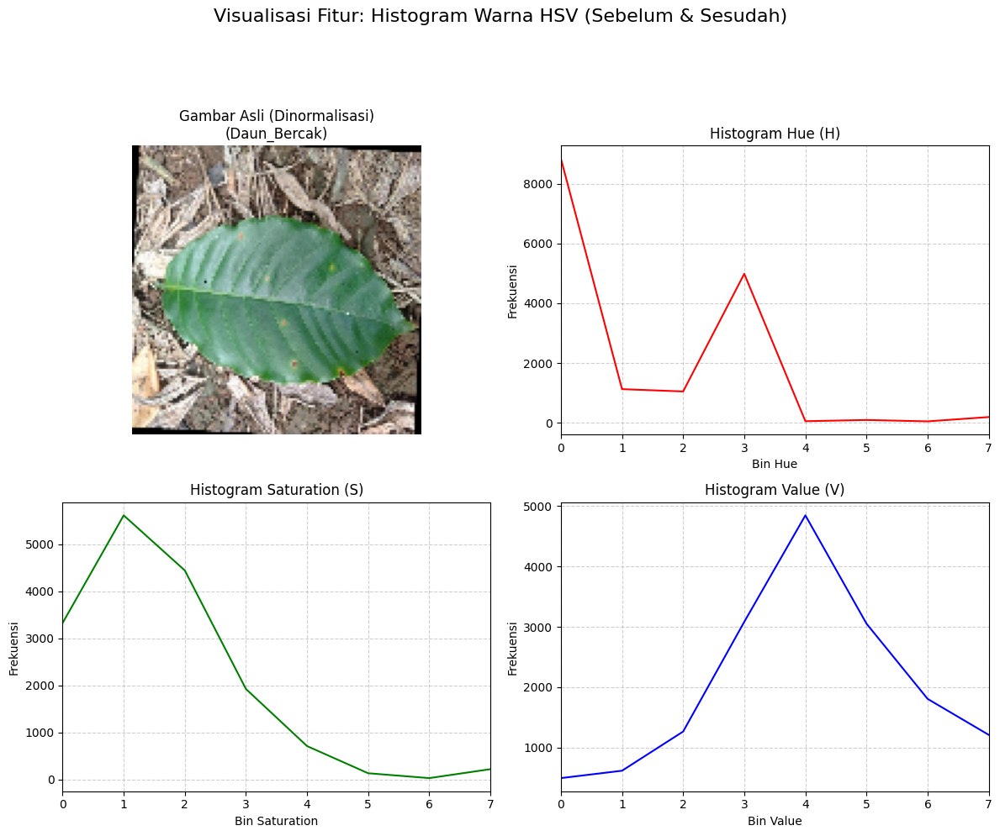


--- Visualisasi Histogram Warna HSV Selesai ---


In [ ]:
# ============================================
# 1. Import Library
# ============================================
import matplotlib.pyplot as plt
import numpy as np
import cv2 # Untuk konversi warna dan grayscale

# ============================================
# 2. Ambil Kembali Variabel Contoh untuk Visualisasi
# ============================================
# Mengambil gambar contoh dari X_train_processed dan y_train_str_processed
# yang seharusnya sudah tersedia setelah sel preprocessing dijalankan.
if 'X_train_processed' in locals() and len(X_train_processed) > 0:
    sample_img_processed = X_train_processed[0] # Gambar Float32 [0,1]
    image_for_processing = (sample_img_processed * 255).astype(np.uint8) # Konversi ke Uint8 [0,255]
    sample_label_processed = y_train_str_processed[0]

    # Pastikan IMG_SIZE juga tersedia, jika tidak, ambil dari shape gambar
    if 'IMG_SIZE' not in locals():
        IMG_SIZE = (image_for_processing.shape[1], image_for_processing.shape[0])
else:
    print("Error: 'X_train_processed' tidak ditemukan atau kosong. Pastikan sel preprocessing sudah dijalankan.")
    sample_img_processed = None # Set ke None agar plot tidak dijalankan
    image_for_processing = None
    sample_label_processed = "N/A"
    IMG_SIZE = (128, 128) # Default atau set sesuai proyek Anda

print("--- Memulai Visualisasi Fitur: Histogram Warna HSV (Sebelum & Sesudah) ---")

if image_for_processing is not None:
    # --- Ekstraksi Histogram HSV dari Contoh Gambar ---
    hsv_img = cv2.cvtColor(image_for_processing, cv2.COLOR_BGR2HSV)
    hist_h = cv2.calcHist([hsv_img], [0], None, [8], [0, 180]).flatten()
    hist_s = cv2.calcHist([hsv_img], [1], None, [8], [0, 256]).flatten()
    hist_v = cv2.calcHist([hsv_img], [2], None, [8], [0, 256]).flatten() # Perbaikan: kanal [2] untuk V

    fig, axes = plt.subplots(2, 2, figsize=(12, 10)) # 2 baris, 2 kolom

    # Gambar Asli (Dinormalisasi & uint8, BGR ke RGB untuk Matplotlib)
    axes[0, 0].imshow(cv2.cvtColor(image_for_processing, cv2.COLOR_BGR2RGB))
    axes[0, 0].set_title(f'Gambar Asli (Dinormalisasi)\n({sample_label_processed})', fontsize=12)
    axes[0, 0].axis('off')

    # Histogram Hue
    axes[0, 1].plot(hist_h, color='red')
    axes[0, 1].set_title('Histogram Hue (H)', fontsize=12)
    axes[0, 1].set_xlim([0, 7])
    axes[0, 1].set_xlabel('Bin Hue')
    axes[0, 1].set_ylabel('Frekuensi')
    axes[0, 1].grid(True, linestyle='--', alpha=0.6)


    # Histogram Saturation
    axes[1, 0].plot(hist_s, color='green')
    axes[1, 0].set_title('Histogram Saturation (S)', fontsize=12)
    axes[1, 0].set_xlim([0, 7])
    axes[1, 0].set_xlabel('Bin Saturation')
    axes[1, 0].set_ylabel('Frekuensi')
    axes[1, 0].grid(True, linestyle='--', alpha=0.6)


    # Histogram Value
    axes[1, 1].plot(hist_v, color='blue')
    axes[1, 1].set_title('Histogram Value (V)', fontsize=12)
    axes[1, 1].set_xlim([0, 7])
    axes[1, 1].set_xlabel('Bin Value')
    axes[1, 1].set_ylabel('Frekuensi')
    axes[1, 1].grid(True, linestyle='--', alpha=0.6)


    plt.suptitle('Visualisasi Fitur: Histogram Warna HSV (Sebelum & Sesudah)', y=1.02, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
else:
    print("  Visualisasi dilewati karena tidak ada gambar contoh.")

print("\n--- Visualisasi Histogram Warna HSV Selesai ---")

Properti Tekstur GLCM (Sebelum & Sesudah)

--- Memulai Visualisasi Fitur: Properti Tekstur GLCM (Sebelum & Sesudah) ---


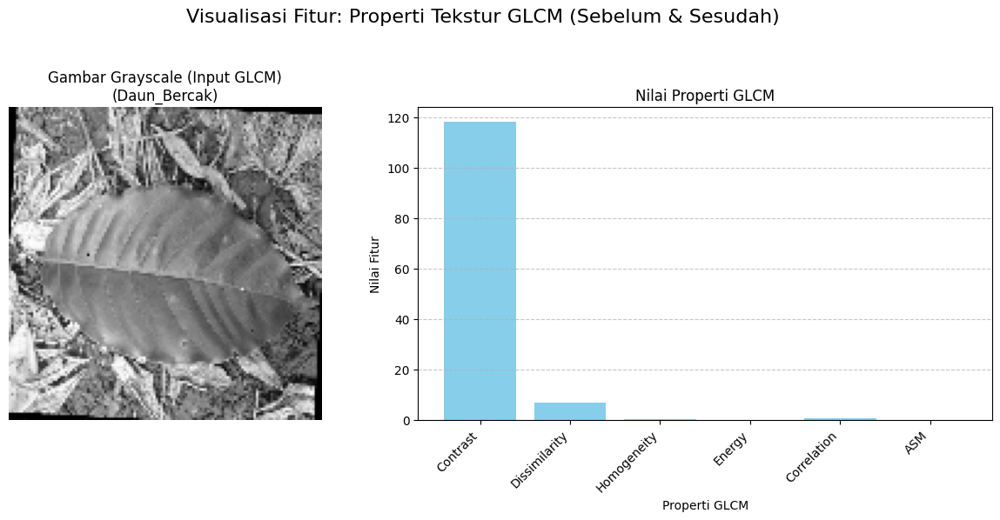


--- Visualisasi Properti Tekstur GLCM Selesai ---


In [ ]:
# ============================================
# 1. Import Library
# ============================================
import matplotlib.pyplot as plt
import numpy as np
import cv2 # Untuk konversi warna dan grayscale
from skimage.feature import graycomatrix, graycoprops # Untuk GLCM

# ============================================
# 2. Ambil Kembali Variabel Contoh untuk Visualisasi
# ============================================
# Variabel ini diasumsikan sudah ada dari sel 'Preprocessing Gambar + Visualisasi' dan 'Ekstraksi Fitur':
# - image_for_processing (gambar contoh uint8 dari X_train_processed, 0-255)
# - sample_label_processed (label string dari gambar contoh)
# - IMG_SIZE (tuple, e.g., (128, 128))

print("--- Memulai Visualisasi Fitur: Properti Tekstur GLCM (Sebelum & Sesudah) ---")

if 'image_for_processing' not in locals() or image_for_processing is None:
    print("Error: Variabel 'image_for_processing' tidak ditemukan. Pastikan sel preprocessing sudah dijalankan.")
else:
    # --- Ekstraksi GLCM dari Contoh Gambar ---
    gray_img = cv2.cvtColor(image_for_processing, cv2.COLOR_BGR2GRAY)
    N_GLCM_LEVELS = 64
    glcm_reduced = (gray_img / (256.0/N_GLCM_LEVELS)).astype(np.uint8)

    distances = [1]
    angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]
    glcm_matrix = graycomatrix(glcm_reduced, distances=distances, angles=angles, levels=N_GLCM_LEVELS, symmetric=True, normed=True)

    glcm_props = {
        'Contrast': graycoprops(glcm_matrix, 'contrast').mean(),
        'Dissimilarity': graycoprops(glcm_matrix, 'dissimilarity').mean(),
        'Homogeneity': graycoprops(glcm_matrix, 'homogeneity').mean(),
        'Energy': graycoprops(glcm_matrix, 'energy').mean(),
        'Correlation': graycoprops(glcm_matrix, 'correlation').mean(),
        'ASM': graycoprops(glcm_matrix, 'ASM').mean()
    }

    plt.figure(figsize=(12, 6))
    gs = plt.GridSpec(1, 2, width_ratios=[1, 1.5]) # GridSpec untuk proporsi yang lebih baik

    ax0 = plt.subplot(gs[0])
    ax0.imshow(gray_img, cmap='gray')
    ax0.set_title(f'Gambar Grayscale (Input GLCM)\n({sample_label_processed})', fontsize=12)
    ax0.axis('off')

    ax1 = plt.subplot(gs[1])
    ax1.bar(glcm_props.keys(), glcm_props.values(), color='skyblue')
    ax1.set_title('Nilai Properti GLCM', fontsize=12)
    ax1.set_ylabel('Nilai Fitur')
    ax1.set_xlabel('Properti GLCM')

    # Rotasi label x
    ax1.tick_params(axis='x', rotation=45)
    # Atur horizontal alignment secara terpisah untuk label x
    plt.setp(ax1.get_xticklabels(), ha='right')

    ax1.grid(axis='y', linestyle='--', alpha=0.7)

    plt.suptitle('Visualisasi Fitur: Properti Tekstur GLCM (Sebelum & Sesudah)', y=1.02, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# --- HAPUS BLOK 'else' INI ---
# else:
#     print("  Visualisasi dilewati karena tidak ada gambar contoh.")
# --- AKHIR HAPUS ---

print("\n--- Visualisasi Properti Tekstur GLCM Selesai ---")

Histogram Local Binary Patterns (LBP) (Sebelum & Sesudah)

--- Memulai Visualisasi Fitur: Histogram LBP (Sebelum & Sesudah) ---


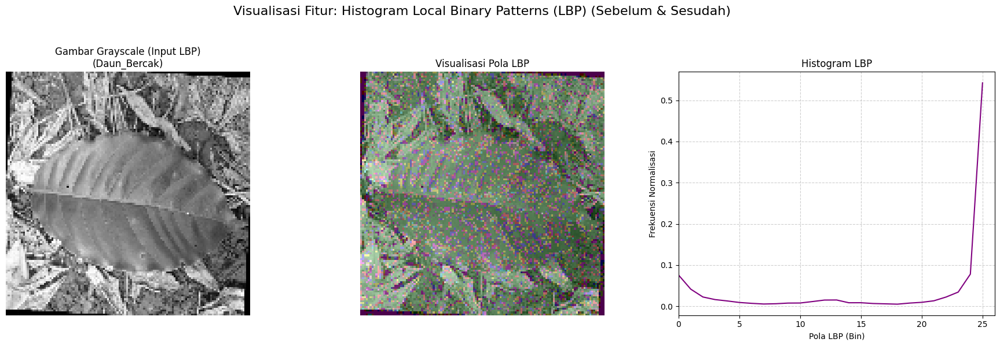


--- Visualisasi Histogram LBP Selesai ---


In [ ]:
# ============================================
# 1. Import Library
# ============================================
import matplotlib.pyplot as plt
import numpy as np
import cv2 # Untuk konversi warna dan grayscale
from skimage.feature import local_binary_pattern # Untuk LBP
from skimage.color import label2rgb # Untuk mewarnai citra LBP agar lebih jelas

# ============================================
# 2. Ambil Kembali Variabel Contoh untuk Visualisasi
# ============================================
# Variabel ini diasumsikan sudah ada dari sel 'Preprocessing Gambar + Visualisasi' dan 'Ekstraksi Fitur':
# - image_for_processing (gambar contoh uint8 dari X_train_processed, 0-255)
# - sample_label_processed (label string dari gambar contoh)
# - IMG_SIZE (tuple, e.g., (128, 128))

print("--- Memulai Visualisasi Fitur: Histogram LBP (Sebelum & Sesudah) ---")

if 'image_for_processing' not in locals() or image_for_processing is None:
    print("Error: Variabel 'image_for_processing' tidak ditemukan. Pastikan sel preprocessing sudah dijalankan.")
else:
    # --- Ekstraksi LBP dari Contoh Gambar ---
    gray_img = cv2.cvtColor(image_for_processing, cv2.COLOR_BGR2GRAY)
    radius = 3
    n_points = 8 * radius
    lbp_img_result = local_binary_pattern(gray_img, n_points, radius, method="uniform")

    # Menghitung histogram LBP
    (lbp_hist, _) = np.histogram(lbp_img_result.ravel(), bins=np.arange(0, n_points + 3), range=(0, n_points + 2))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-6) # Normalisasi histogram

    fig, axes = plt.subplots(1, 3, figsize=(18, 6)) # 1 baris, 3 kolom

    # Gambar Grayscale (Input LBP)
    axes[0].imshow(gray_img, cmap='gray')
    axes[0].set_title(f'Gambar Grayscale (Input LBP)\n({sample_label_processed})', fontsize=12)
    axes[0].axis('off')

    # Visualisasi Pola LBP (membuat citra LBP lebih visual)
    lbp_colored = label2rgb(lbp_img_result.astype(int), image=gray_img, bg_label=0)
    axes[1].imshow(lbp_colored)
    axes[1].set_title('Visualisasi Pola LBP', fontsize=12)
    axes[1].axis('off')

    # Histogram LBP
    axes[2].plot(lbp_hist, color='purple')
    axes[2].set_title('Histogram LBP', fontsize=12)
    axes[2].set_xlabel('Pola LBP (Bin)')
    axes[2].set_ylabel('Frekuensi Normalisasi')
    axes[2].set_xlim([0, n_points + 2])
    axes[2].grid(True, linestyle='--', alpha=0.6)

    plt.suptitle('Visualisasi Fitur: Histogram Local Binary Patterns (LBP) (Sebelum & Sesudah)', y=1.02, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

print("\n--- Visualisasi Histogram LBP Selesai ---")

Distribusi Fitur & Reduksi Dimensi


--- Memulai Visualisasi Distribusi Fitur & Klaster ---

[3.1] Visualisasi Distribusi Beberapa Fitur Individual per Kelas (dari seluruh Training Set):


/tmp/ipython-input-3038707288.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='label_name', y=feature_idx, data=df_features, ax=axes[2*i], palette='viridis')
/tmp/ipython-input-3038707288.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='label_name', y=feature_idx, data=df_features, ax=axes[2*i], palette='viridis')
/tmp/ipython-input-3038707288.py:55: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='label_name', y=feature_idx, data=df_features, ax=axes[2*i], palette='viridis')
/tmp/ipython-input-3038707288.py:55: FutureWarning: 

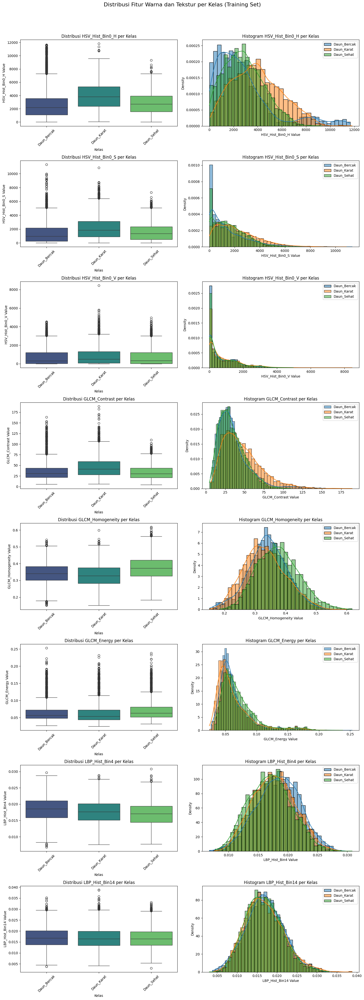


[3.2] Visualisasi Klaster Fitur dengan t-SNE (Reduksi Dimensi):


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


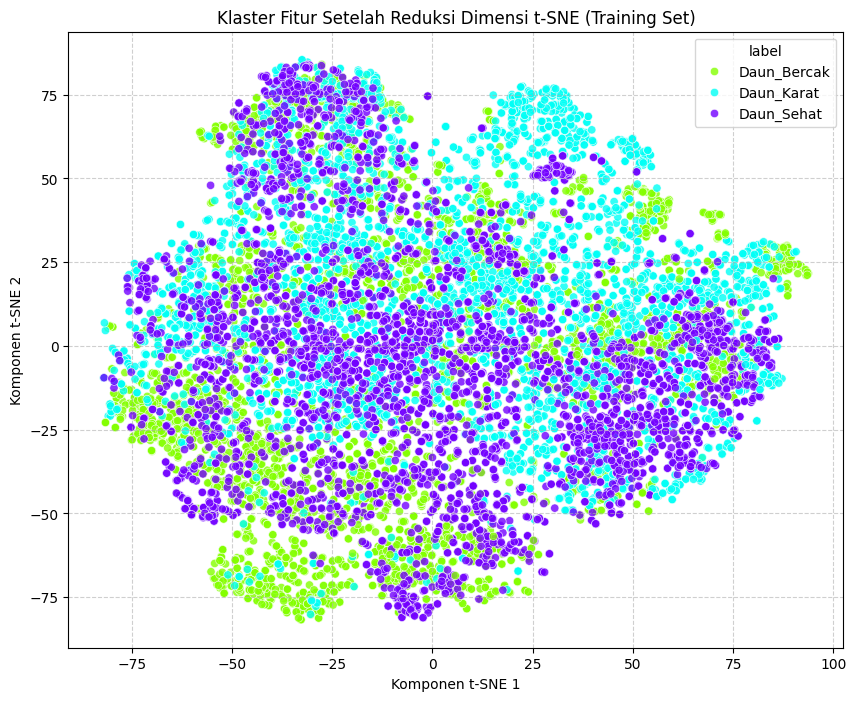


--- Visualisasi Distribusi Fitur & Klaster Selesai ---


In [ ]:
# ============================================
# 1. Import Library
# ============================================
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA # Tambahan untuk PCA alternatif
from sklearn.preprocessing import LabelEncoder # Pastikan LabelEncoder juga tersedia

# ============================================
# 2. Asumsi Variabel Tersedia
# ============================================
# Variabel ini diasumsikan sudah ada dari sel 'Ekstraksi Fitur':
# - X_train_features, y_train_encoded
# - le (LabelEncoder object)
# - initial_class_names (list of class names) -> Bisa juga di-derive dari le.classes_

print("\n--- Memulai Visualisasi Distribusi Fitur & Klaster ---")

# --- Perbaikan: Hanya satu blok if/else untuk pengecekan awal ---
if 'X_train_features' not in locals() or X_train_features is None or len(X_train_features) == 0:
    print("Error: 'X_train_features' tidak ditemukan atau kosong. Pastikan sel ekstraksi fitur sudah dijalankan. Visualisasi dilewati.")
else:
    # ============================================
    # 3. Visualisasi Distribusi Fitur Individual (Histogram/Box Plot)
    # ============================================
    print("\n[3.1] Visualisasi Distribusi Beberapa Fitur Individual per Kelas (dari seluruh Training Set):")

    # Buat DataFrame untuk mempermudah visualisasi dengan Seaborn
    df_features = pd.DataFrame(X_train_features)
    df_features['label_encoded'] = y_train_encoded
    df_features['label_name'] = le.inverse_transform(y_train_encoded)

    # Identifikasi indeks fitur untuk setiap kategori (sama seperti sebelumnya)
    # Total = 24 (HSV) + 6 (GLCM) + 26 (LBP) = 56 fitur

    selected_feature_indices = {
        'HSV_Hist_Bin0_H': 0,    # Bin pertama Hue
        'HSV_Hist_Bin0_S': 8,    # Bin pertama Saturation
        'HSV_Hist_Bin0_V': 16,   # Bin pertama Value
        'GLCM_Contrast': 24,     # Index Contrast
        'GLCM_Homogeneity': 26,  # Index Homogeneity
        'GLCM_Energy': 27,       # Index Energy
        'LBP_Hist_Bin4': 24 + 6 + 4, # Index LBP bin ke-4 (setelah HSV & GLCM)
        'LBP_Hist_Bin14': 24 + 6 + 14 # Index LBP bin ke-14
    }

    fig, axes = plt.subplots(len(selected_feature_indices), 2, figsize=(15, 5 * len(selected_feature_indices)))
    axes = axes.flatten()

    for i, (feature_name, feature_idx) in enumerate(selected_feature_indices.items()):
        sns.boxplot(x='label_name', y=feature_idx, data=df_features, ax=axes[2*i], palette='viridis')
        axes[2*i].set_title(f'Distribusi {feature_name} per Kelas')
        axes[2*i].set_xlabel('Kelas')
        axes[2*i].set_ylabel(f'{feature_name} Value')
        axes[2*i].tick_params(axis='x', rotation=45)

        for class_name in le.classes_:
            sns.histplot(df_features[df_features['label_name'] == class_name][feature_idx],
                         kde=True, stat='density', label=class_name, ax=axes[2*i+1])
        axes[2*i+1].set_title(f'Histogram {feature_name} per Kelas')
        axes[2*i+1].set_xlabel(f'{feature_name} Value')
        axes[2*i+1].set_ylabel('Density')
        axes[2*i+1].legend()

    plt.suptitle('Distribusi Fitur Warna dan Tekstur per Kelas (Training Set)', y=1.02, fontsize=16)
    plt.tight_layout()
    plt.show()

    # ============================================
    # 4. Visualisasi Reduksi Dimensi (t-SNE/PCA untuk melihat klaster)
    # ============================================
    print("\n[3.2] Visualisasi Klaster Fitur dengan t-SNE (Reduksi Dimensi):")

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train_features)

    try:
        tsne = TSNE(n_components=2, random_state=42, n_jobs=-1, perplexity=30, n_iter=1000)
        X_train_tsne = tsne.fit_transform(X_train_scaled)

        df_tsne = pd.DataFrame(X_train_tsne, columns=['Dimensi 1', 'Dimensi 2'])
        df_tsne['label'] = le.inverse_transform(y_train_encoded)

        plt.figure(figsize=(10, 8))
        sns.scatterplot(
            x='Dimensi 1', y='Dimensi 2',
            hue='label',
            palette=sns.color_palette("hsv", len(le.classes_)),
            data=df_tsne,
            legend="full",
            alpha=0.8
        )
        plt.title('Klaster Fitur Setelah Reduksi Dimensi t-SNE (Training Set)')
        plt.xlabel('Komponen t-SNE 1')
        plt.ylabel('Komponen t-SNE 2')
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.show()

    except Exception as e:
        print(f"  Gagal menjalankan t-SNE: {e}")
        print("  (t-SNE mungkin butuh waktu atau resource besar. Pertimbangkan PCA untuk visualisasi yang lebih cepat).")

        pca_vis = PCA(n_components=2, random_state=42)
        X_train_pca_vis = pca_vis.fit_transform(X_train_scaled)
        df_pca_vis = pd.DataFrame(X_train_pca_vis, columns=['Principal Component 1', 'Principal Component 2'])
        df_pca_vis['label'] = le.inverse_transform(y_train_encoded)

        plt.figure(figsize=(10, 8))
        sns.scatterplot(
            x='Principal Component 1', y='Principal Component 2',
            hue='label',
            palette=sns.color_palette("hsv", len(le.classes_)),
            data=df_pca_vis,
            legend="full",
            alpha=0.8
        )
        plt.title('Klaster Fitur Setelah Reduksi Dimensi PCA (Training Set)')
        plt.xlabel(f'Principal Component 1 ({pca_vis.explained_variance_ratio_[0]*100:.2f}%)')
        plt.ylabel(f'Principal Component 2 ({pca_vis.explained_variance_ratio_[1]*100:.2f}%)')
        plt.grid(True, linestyle='--', alpha=0.6)
        plt.show()


print("\n--- Visualisasi Distribusi Fitur & Klaster Selesai ---")

#**Preprocessing Fitur (Scaling & Reduksi Dimensi Opsional)**

In [ ]:
# ============================================
# 1. Import Library
# ============================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler # Untuk Scaling
from sklearn.decomposition import PCA # Untuk Reduksi Dimensi

# ============================================
# 2. Asumsi Variabel Tersedia dari Ekstraksi Fitur
# ============================================
# Kode ini mengasumsikan variabel-variabel berikut sudah ada dari sel 'Ekstraksi Fitur':
# - X_train_features, y_train_encoded
# - X_val_features, y_val_encoded
# - X_test_features, y_test_encoded
# - le (LabelEncoder object)

print("--- Memulai Preprocessing Fitur (Scaling & Reduksi Dimensi Opsional) ---")

# --- Pengecekan Awal Variabel ---
if 'X_train_features' not in locals() or X_train_features is None or len(X_train_features) == 0:
    print("Error: 'X_train_features' tidak ditemukan atau kosong. Pastikan sel ekstraksi fitur sudah dijalankan.")
    # Hentikan eksekusi atau inisialisasi kosong untuk mencegah error lebih lanjut
    raise ValueError("Data fitur tidak tersedia untuk preprocessing.")

# ============================================
# 3. Scaling Fitur (Wajib)
# ============================================
# Mengubah skala fitur agar memiliki rata-rata 0 dan standar deviasi 1 (StandardScaler).

print("\n[3.1] Scaling fitur menggunakan StandardScaler...")

final_scaler = StandardScaler() # Simpan scaler ini untuk digunakan nanti saat inferensi

# Fit scaler HANYA pada data training, lalu transform ke semua split
# Input adalah X_train_features langsung dari ekstraksi fitur
X_train_scaled = final_scaler.fit_transform(X_train_features)
X_val_scaled = final_scaler.transform(X_val_features)
X_test_scaled = final_scaler.transform(X_test_features)

print(f"  Shape X_train_scaled: {X_train_scaled.shape}")
print(f"  Contoh fitur X_train_scaled[0] (beberapa elemen awal): {X_train_scaled[0][:10]}")
print(f"  Rata-rata fitur pertama X_train_scaled: {X_train_scaled[:,0].mean():.4f}")
print(f"  Std Dev fitur pertama X_train_scaled: {X_train_scaled[:,0].std():.4f}")

print("  Scaling fitur selesai.")

# ============================================
# 4. Reduksi Dimensi (Opsional: PCA)
# ============================================
# PCA membantu mengurangi jumlah fitur sambil mempertahankan variansi data terbesar.

PERFORM_PCA = False # Atur ke False jika Anda tidak ingin menggunakan PCA

if PERFORM_PCA:
    print("\n[4.1] Menerapkan Reduksi Dimensi dengan PCA...")

    # Menentukan jumlah komponen PCA (misalnya 95% variansi)
    final_pca = PCA(n_components=0.95, random_state=42) # Simpan objek PCA

    # Fit PCA HANYA pada data training yang sudah di-scale, lalu transform ke semua split
    X_train_final = final_pca.fit_transform(X_train_scaled)
    X_val_final = final_pca.transform(X_val_scaled)
    X_test_final = final_pca.transform(X_test_scaled)

    print(f"  Jumlah fitur asli (setelah scaling, sebelum PCA): {X_train_scaled.shape[1]}")
    print(f"  Jumlah komponen setelah PCA: {X_train_final.shape[1]}")
    print(f"  Variansi kumulatif yang dijelaskan oleh komponen terpilih: {final_pca.explained_variance_ratio_.sum():.4f}")
    print(f"  Shape X_train_final (fitur training setelah PCA): {X_train_final.shape}")
    print(f"  Shape X_val_final (fitur validasi setelah PCA): {X_val_final.shape}")
    print(f"  Shape X_test_final (fitur testing setelah PCA): {X_test_final.shape}")

    # Visualisasi Kumulatif Explained Variance Ratio
    plt.figure(figsize=(10, 5))
    plt.plot(np.cumsum(final_pca.explained_variance_ratio_))
    plt.xlabel('Jumlah Komponen Utama')
    plt.ylabel('Kumulatif Explained Variance Ratio')
    plt.title('Kumulatif Explained Variance oleh PCA')
    plt.grid(True)
    plt.axhline(y=0.95, color='r', linestyle='--', label='95% Variansi Target')
    # Temukan jumlah komponen untuk 95% variansi jika n_components diatur ke float
    n_components_at_95 = np.where(np.cumsum(final_pca.explained_variance_ratio_) >= 0.95)[0][0] + 1
    plt.axvline(x=n_components_at_95 - 1, color='g', linestyle='--', label=f'Komponen untuk 95% Variansi ({n_components_at_95})')
    plt.legend()
    plt.show()

    print("  Reduksi Dimensi dengan PCA selesai.")

else:
    print("\n[4.1] Reduksi Dimensi dengan PCA dilewati (PERFORM_PCA = False).")
    X_train_final = X_train_scaled
    X_val_final = X_val_scaled
    X_test_final = X_test_scaled

# ============================================
# 5. Ringkasan Akhir Preprocessing Fitur
# ============================================
print("\n--- Ringkasan Akhir Preprocessing Fitur ---")
print(f"Final Training Set Features (X_train_final): {X_train_final.shape}")
print(f"Final Validation Set Features (X_val_final): {X_val_final.shape}")
print(f"Final Test Set Features (X_test_final): {X_test_final.shape}")
print(f"\nFinal Training Set Labels (y_train_encoded): {y_train_encoded.shape}")
print(f"Final Validation Set Labels (y_val_encoded): {y_val_encoded.shape}")
print(f"Final Test Set Labels (y_test_encoded): {y_test_encoded.shape}")

print("\n--- Preprocessing Fitur Selesai ---")
print("Data fitur sekarang sudah di-scale dan (opsional) direduksi dimensinya. Siap untuk Pelatihan Model!")

--- Memulai Preprocessing Fitur (Scaling & Reduksi Dimensi Opsional) ---

[3.1] Scaling fitur menggunakan StandardScaler...
  Shape X_train_scaled: (10800, 56)
  Contoh fitur X_train_scaled[0] (beberapa elemen awal): [ 2.65424952 -0.87336105 -2.04762513  1.7468705  -0.31950305  0.00916623
 -0.10909684  0.02147997  1.04970506  1.76811306]
  Rata-rata fitur pertama X_train_scaled: -0.0000
  Std Dev fitur pertama X_train_scaled: 1.0000
  Scaling fitur selesai.

[4.1] Reduksi Dimensi dengan PCA dilewati (PERFORM_PCA = False).

--- Ringkasan Akhir Preprocessing Fitur ---
Final Training Set Features (X_train_final): (10800, 56)
Final Validation Set Features (X_val_final): (450, 56)
Final Test Set Features (X_test_final): (450, 56)

Final Training Set Labels (y_train_encoded): (10800,)
Final Validation Set Labels (y_val_encoded): (450,)
Final Test Set Labels (y_test_encoded): (450,)

--- Preprocessing Fitur Selesai ---
Data fitur sekarang sudah di-scale dan (opsional) direduksi dimensinya. Si

#**Seleksi fitur**

--- BAGIAN 7: Seleksi Fitur (SelectKBest) ---

[7.1] Menerapkan Seleksi Fitur menggunakan SelectKBest (memilih 25 fitur terbaik)...
  Melakukan scaling fitur sementara untuk Seleksi Fitur...
  Jumlah fitur asli: 56
  Jumlah fitur setelah seleksi: 25


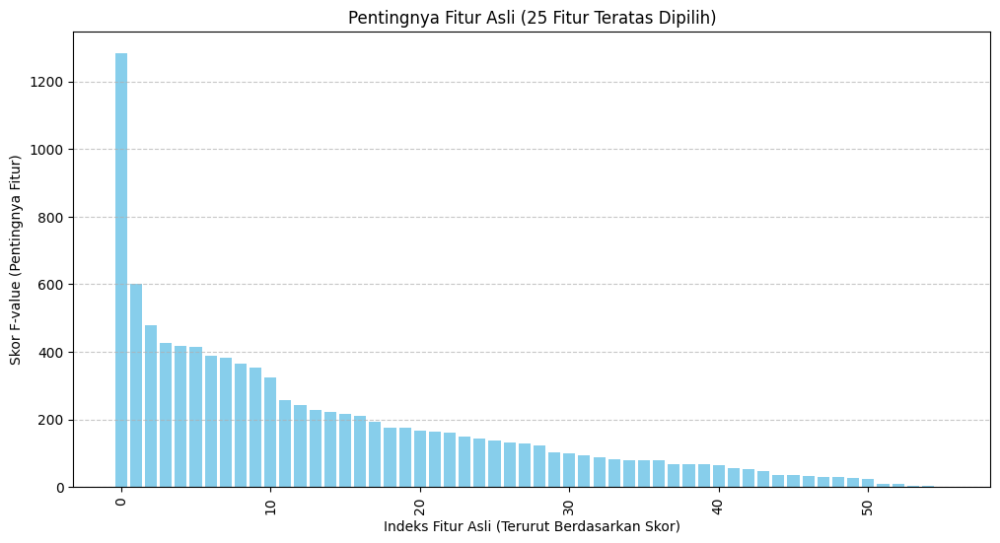

  Seleksi fitur selesai.

--- Ringkasan Setelah Seleksi Fitur (atau Tanpa Seleksi) ---
Final Training Set Features (X_train_processed_features): (10800, 25)
Final Validation Set Features (X_val_processed_features): (450, 25)
Final Test Set Features (X_test_processed_features): (450, 25)
--- Seleksi Fitur Selesai ---



In [ ]:
# ============================================
# BAGIAN 7: Seleksi Fitur (SelectKBest - Filter Method)
# ============================================
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.preprocessing import StandardScaler
import numpy as np # Sudah ada, tapi memastikan
import matplotlib.pyplot as plt # Sudah ada, tapi memastikan

print("--- BAGIAN 7: Seleksi Fitur (SelectKBest) ---")

# ============================================
# 7.1. Konfigurasi Seleksi Fitur
# ============================================
# --- PENTING: Atur PERFORM_FEATURE_SELECTION = True untuk mengaktifkan seleksi fitur ---
# --- Jika False, data X_train_features, dll. akan langsung dilewatkan tanpa seleksi. ---
PERFORM_FEATURE_SELECTION = True # <--- AKTIFKAN SELEKSI FITUR UNTUK EKSPERIMEN INI

# Jumlah fitur terbaik yang ingin dipilih (dari 56 fitur asli)
NUM_FEATURES_TO_SELECT = 25

# ============================================
# 7.2. Implementasi Seleksi Fitur
# ============================================
# Pengecekan awal ketersediaan data fitur dari tahap Ekstraksi Fitur
if 'X_train_features' not in locals() or X_train_features is None or len(X_train_features) == 0:
    print("Error: 'X_train_features' tidak ditemukan atau kosong. Pastikan sel ekstraksi fitur sudah dijalankan.")
    # Inisialisasi variabel output agar sel berikutnya tidak error
    X_train_processed_features = np.array([])
    X_val_processed_features = np.array([])
    X_test_processed_features = np.array([])
    # Juga inisialisasi scaler dan selector untuk menghindari NameError di sel berikutnya
    feature_scaler = None
    feature_selector = None
else:
    if PERFORM_FEATURE_SELECTION:
        print(f"\n[7.1] Menerapkan Seleksi Fitur menggunakan SelectKBest (memilih {NUM_FEATURES_TO_SELECT} fitur terbaik)...")

        # --- Scaling Fitur SEBELUM Seleksi Fitur ---
        # Scaling penting karena SelectKBest (terutama dengan f_classif) bisa dipengaruhi oleh skala.
        print("  Melakukan scaling fitur sementara untuk Seleksi Fitur...")
        feature_scaler = StandardScaler() # Simpan scaler ini (bukan final_scaler)
        X_train_scaled_for_selection = feature_scaler.fit_transform(X_train_features)
        X_val_scaled_for_selection = feature_scaler.transform(X_val_features)
        X_test_scaled_for_selection = feature_scaler.transform(X_test_features)

        # Inisialisasi SelectKBest
        # f_classif (ANOVA F-value) cocok untuk klasifikasi dengan fitur numerik.
        feature_selector = SelectKBest(f_classif, k=NUM_FEATURES_TO_SELECT) # Simpan selector ini

        # Fit selector HANYA pada data training, lalu transform ke semua split
        X_train_selected = feature_selector.fit_transform(X_train_scaled_for_selection, y_train_encoded)
        X_val_selected = feature_selector.transform(X_val_scaled_for_selection)
        X_test_selected = feature_selector.transform(X_test_scaled_for_selection)

        print(f"  Jumlah fitur asli: {X_train_features.shape[1]}")
        print(f"  Jumlah fitur setelah seleksi: {X_train_selected.shape[1]}")

        # --- Visualisasi Pentingnya Fitur ---
        feature_scores = feature_selector.scores_
        # Urutkan fitur dari yang tertinggi skornya
        feature_indices = np.argsort(feature_scores)[::-1]
        sorted_scores = feature_scores[feature_indices]

        plt.figure(figsize=(12, 6))
        plt.bar(range(X_train_features.shape[1]), sorted_scores, color='skyblue')
        plt.xlabel('Indeks Fitur Asli (Terurut Berdasarkan Skor)')
        plt.ylabel('Skor F-value (Pentingnya Fitur)')
        plt.title(f'Pentingnya Fitur Asli ({NUM_FEATURES_TO_SELECT} Fitur Teratas Dipilih)')
        plt.xticks(rotation=90)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()

        # Variabel output utama dari sel ini (fitur yang sudah diseleksi)
        X_train_processed_features = X_train_selected
        X_val_processed_features = X_val_selected
        X_test_processed_features = X_test_selected

        print("  Seleksi fitur selesai.")

    else:
        print("\n[7.1] Seleksi Fitur dilewati (PERFORM_FEATURE_SELECTION = False).")
        # Jika seleksi fitur dilewati, gunakan fitur asli (dari ekstraksi)
        X_train_processed_features = X_train_features
        X_val_processed_features = X_val_features
        X_test_processed_features = X_test_features

        feature_scaler = None # Tidak ada scaler spesifik dari seleksi fitur jika dilewati
        feature_selector = None # Tidak ada selector jika dilewati


# ============================================
# 7.3. Ringkasan Setelah Seleksi Fitur
# ============================================
print("\n--- Ringkasan Setelah Seleksi Fitur (atau Tanpa Seleksi) ---")
print(f"Final Training Set Features (X_train_processed_features): {X_train_processed_features.shape}")
print(f"Final Validation Set Features (X_val_processed_features): {X_val_processed_features.shape}")
print(f"Final Test Set Features (X_test_processed_features): {X_test_processed_features.shape}")
print("--- Seleksi Fitur Selesai ---\n")

#**Training model**

--- Memulai Pemilihan Model & Pelatihan (Multi Model) ---

[5.1] Memulai pelatihan dan hyperparameter tuning untuk setiap model...


--- Melatih Support Vector Machine (SVM) ---
Fitting 5 folds for each of 18 candidates, totalling 90 fits

  ✅ Support Vector Machine (SVM) selesai dilatih dalam 2942.79 detik.
  🔧 Best Params: {'C': 10, 'class_weight': None, 'gamma': 'scale', 'kernel': 'rbf'}
  📈 CV Best F1-weighted: 0.8532

--- Melatih Random Forest ---
Fitting 5 folds for each of 36 candidates, totalling 180 fits

  ✅ Random Forest selesai dilatih dalam 1500.71 detik.
  🔧 Best Params: {'class_weight': None, 'max_depth': 20, 'min_samples_leaf': 1, 'n_estimators': 100}
  📈 CV Best F1-weighted: 0.8212

--- Melatih K-Nearest Neighbors (KNN) ---
Fitting 5 folds for each of 16 candidates, totalling 80 fits

  ✅ K-Nearest Neighbors (KNN) selesai dilatih dalam 48.26 detik.
  🔧 Best Params: {'metric': 'manhattan', 'n_neighbors': 3, 'weights': 'distance'}
  📈 CV Best F1-weighted: 0.7866

--- Mel

/tmp/ipython-input-2156872592.py:134: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Validation F1-weighted', y='Model', data=df_results, palette='viridis')


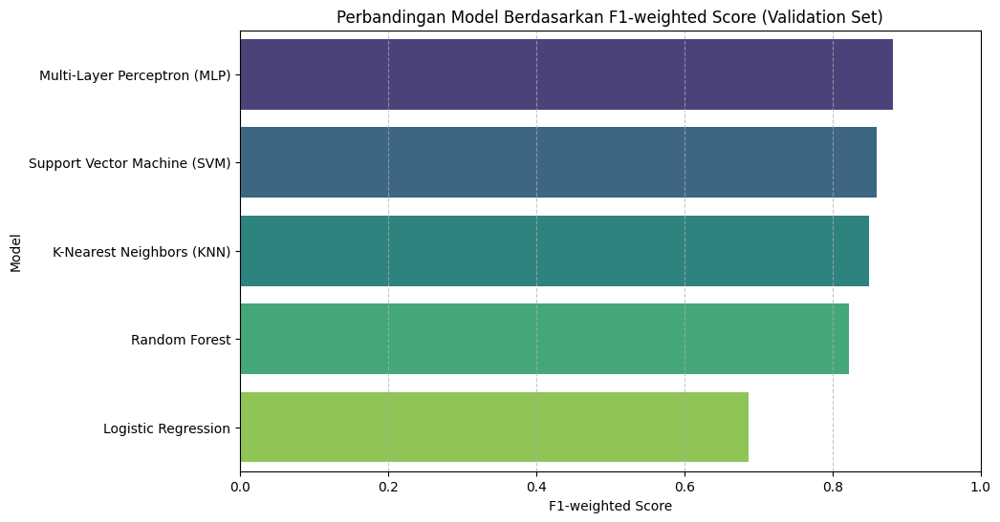


✅ Semua model telah dilatih dan disimpan dalam dictionary 'best_models'.


In [ ]:
# ============================================
# 1. Import Library
# ============================================
import numpy as np
import pandas as pd
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
import matplotlib.pyplot as plt
import seaborn as sns
import time

# ============================================
# 2. Asumsi Variabel Tersedia dari Preprocessing
# ============================================
print("--- Memulai Pemilihan Model & Pelatihan (Multi Model) ---")

if 'X_train_final' not in locals() or X_train_final is None or len(X_train_final) == 0:
    raise ValueError("Data fitur final tidak tersedia. Jalankan preprocessing fitur terlebih dahulu.")
if 'y_train_encoded' not in locals() or y_train_encoded is None or len(y_train_encoded) == 0:
    raise ValueError("Label training tidak tersedia. Jalankan ekstraksi fitur terlebih dahulu.")

# ============================================
# 3. Konfigurasi Cross-Validation
# ============================================
N_SPLITS = 5
skf = StratifiedKFold(n_splits=N_SPLITS, shuffle=True, random_state=42)

# ============================================
# 4. Definisi Model dan Grid Search Parameters
# ============================================
models_to_train = {
    "Support Vector Machine (SVM)": {
        "model": SVC(random_state=42, probability=True),
        "param_grid": {
            'C': [0.1, 1, 10],
            'gamma': [0.1, 0.01, 'scale'],
            'kernel': ['rbf'],
            'class_weight': [None, 'balanced']
        }
    },
    "Random Forest": {
        "model": RandomForestClassifier(random_state=42),
        "param_grid": {
            'n_estimators': [100, 200],
            'max_depth': [None, 10, 20],
            'min_samples_leaf': [1, 2, 4],
            'class_weight': [None, 'balanced']
        }
    },
    "K-Nearest Neighbors (KNN)": {
        "model": KNeighborsClassifier(),
        "param_grid": {
            'n_neighbors': [3, 5, 7, 9],
            'weights': ['uniform', 'distance'],
            'metric': ['euclidean', 'manhattan']
        }
    },
    "Logistic Regression": {
        "model": LogisticRegression(random_state=42, solver='liblinear', max_iter=1000),
        "param_grid": {
            'C': [0.1, 1, 10],
            'penalty': ['l1', 'l2'],
            'class_weight': [None, 'balanced']
        }
    },
    "Multi-Layer Perceptron (MLP)": {
        "model": MLPClassifier(random_state=42, max_iter=500),
        "param_grid": {
            'hidden_layer_sizes': [(64,), (128,), (64, 32)],
            'activation': ['relu', 'tanh'],
            'solver': ['adam'],
            'alpha': [0.0001, 0.001],
            'learning_rate': ['constant', 'adaptive']
        }
    }
}

# ============================================
# 5. Training & Hyperparameter Tuning
# ============================================
best_models = {}
results = []

print("\n[5.1] Memulai pelatihan dan hyperparameter tuning untuk setiap model...\n")

for model_name, config in models_to_train.items():
    print(f"\n--- Melatih {model_name} ---")
    start_time = time.time()

    grid_search = GridSearchCV(
        estimator=config["model"],
        param_grid=config["param_grid"],
        cv=skf,
        scoring='f1_weighted',
        n_jobs=-1,
        verbose=1
    )

    grid_search.fit(X_train_final, y_train_encoded)
    end_time = time.time()

    best_model = grid_search.best_estimator_
    best_models[model_name] = best_model

    print(f"\n  ✅ {model_name} selesai dilatih dalam {end_time - start_time:.2f} detik.")
    print(f"  🔧 Best Params: {grid_search.best_params_}")
    print(f"  📈 CV Best F1-weighted: {grid_search.best_score_:.4f}")

    # Evaluasi pada validation set
    y_pred_val = best_model.predict(X_val_final)
    acc = accuracy_score(y_val_encoded, y_pred_val)
    f1w = f1_score(y_val_encoded, y_pred_val, average='weighted')

    results.append({
        "Model": model_name,
        "CV F1-weighted Score": grid_search.best_score_,
        "Validation Accuracy": acc,
        "Validation F1-weighted": f1w
    })

# ============================================
# 6. Tabel & Visualisasi Perbandingan Model
# ============================================
df_results = pd.DataFrame(results).sort_values(by="Validation F1-weighted", ascending=False)
print("\n\n--- 🔍 Perbandingan Model (Validation Set) ---")
print(df_results[['Model', 'Validation Accuracy', 'Validation F1-weighted']])

plt.figure(figsize=(10, 6))
sns.barplot(x='Validation F1-weighted', y='Model', data=df_results, palette='viridis')
plt.title('Perbandingan Model Berdasarkan F1-weighted Score (Validation Set)')
plt.xlabel('F1-weighted Score')
plt.ylabel('Model')
plt.xlim([0, 1])
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

print("\n✅ Semua model telah dilatih dan disimpan dalam dictionary 'best_models'.")


#**Evaluasi model**

--- Memulai Evaluasi Semua Model pada Test Set ---

🔍 Evaluasi Model: Support Vector Machine (SVM)
  ✅ Akurasi: 0.8711
  ⚖️  F1-weighted: 0.8713
  📊 Precision (Macro): 0.8722
  📊 Recall (Macro): 0.8711
  📊 F1-score (Macro): 0.8713

  Classification Report:
              precision    recall  f1-score   support

 Daun_Bercak       0.86      0.84      0.85       150
  Daun_Karat       0.92      0.88      0.90       150
  Daun_Sehat       0.84      0.89      0.87       150

    accuracy                           0.87       450
   macro avg       0.87      0.87      0.87       450
weighted avg       0.87      0.87      0.87       450



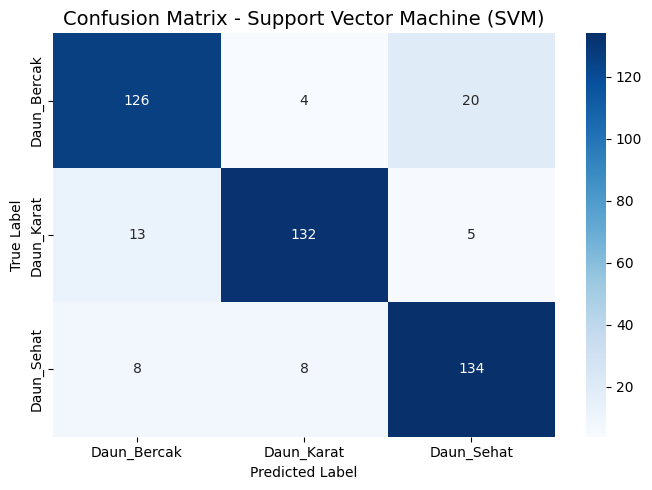


🔍 Evaluasi Model: Random Forest
  ✅ Akurasi: 0.8111
  ⚖️  F1-weighted: 0.8114
  📊 Precision (Macro): 0.8136
  📊 Recall (Macro): 0.8111
  📊 F1-score (Macro): 0.8114

  Classification Report:
              precision    recall  f1-score   support

 Daun_Bercak       0.86      0.79      0.82       150
  Daun_Karat       0.81      0.82      0.81       150
  Daun_Sehat       0.77      0.83      0.80       150

    accuracy                           0.81       450
   macro avg       0.81      0.81      0.81       450
weighted avg       0.81      0.81      0.81       450



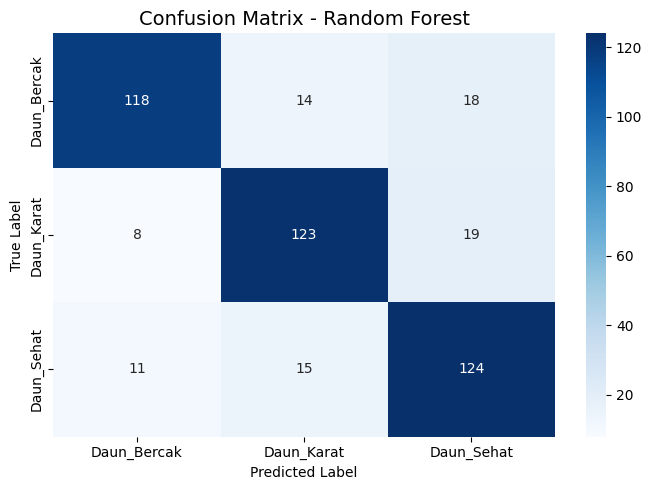


🔍 Evaluasi Model: K-Nearest Neighbors (KNN)
  ✅ Akurasi: 0.8089
  ⚖️  F1-weighted: 0.8086
  📊 Precision (Macro): 0.8086
  📊 Recall (Macro): 0.8089
  📊 F1-score (Macro): 0.8086

  Classification Report:
              precision    recall  f1-score   support

 Daun_Bercak       0.79      0.76      0.78       150
  Daun_Karat       0.83      0.83      0.83       150
  Daun_Sehat       0.81      0.83      0.82       150

    accuracy                           0.81       450
   macro avg       0.81      0.81      0.81       450
weighted avg       0.81      0.81      0.81       450



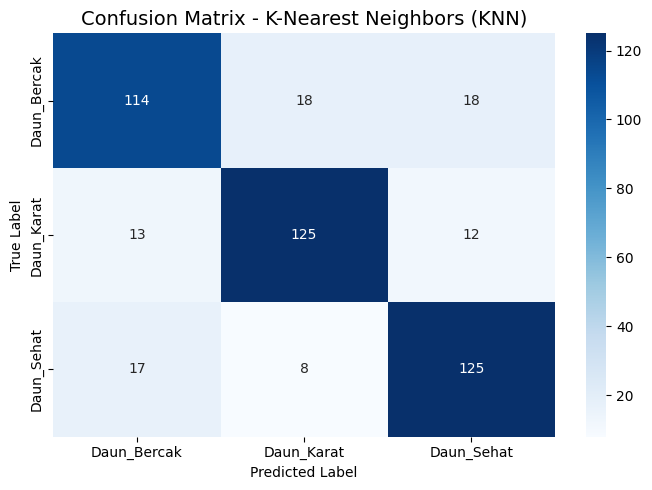


🔍 Evaluasi Model: Logistic Regression
  ✅ Akurasi: 0.7267
  ⚖️  F1-weighted: 0.7265
  📊 Precision (Macro): 0.7292
  📊 Recall (Macro): 0.7267
  📊 F1-score (Macro): 0.7265

  Classification Report:
              precision    recall  f1-score   support

 Daun_Bercak       0.74      0.71      0.72       150
  Daun_Karat       0.76      0.69      0.72       150
  Daun_Sehat       0.69      0.78      0.73       150

    accuracy                           0.73       450
   macro avg       0.73      0.73      0.73       450
weighted avg       0.73      0.73      0.73       450



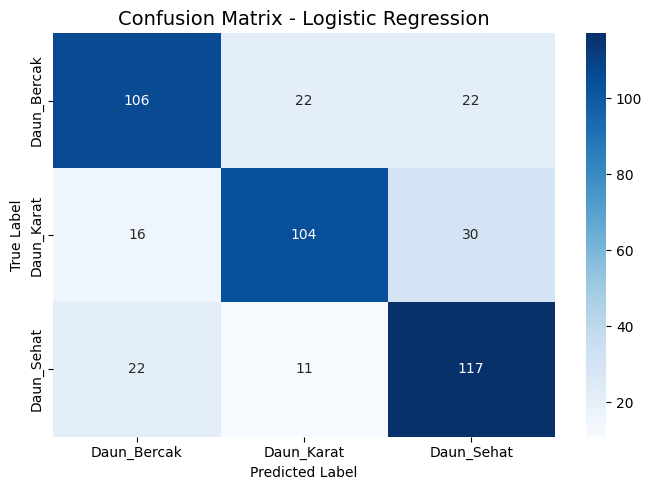


🔍 Evaluasi Model: Multi-Layer Perceptron (MLP)
  ✅ Akurasi: 0.8644
  ⚖️  F1-weighted: 0.8645
  📊 Precision (Macro): 0.8646
  📊 Recall (Macro): 0.8644
  📊 F1-score (Macro): 0.8645

  Classification Report:
              precision    recall  f1-score   support

 Daun_Bercak       0.85      0.86      0.85       150
  Daun_Karat       0.89      0.87      0.88       150
  Daun_Sehat       0.86      0.86      0.86       150

    accuracy                           0.86       450
   macro avg       0.86      0.86      0.86       450
weighted avg       0.86      0.86      0.86       450



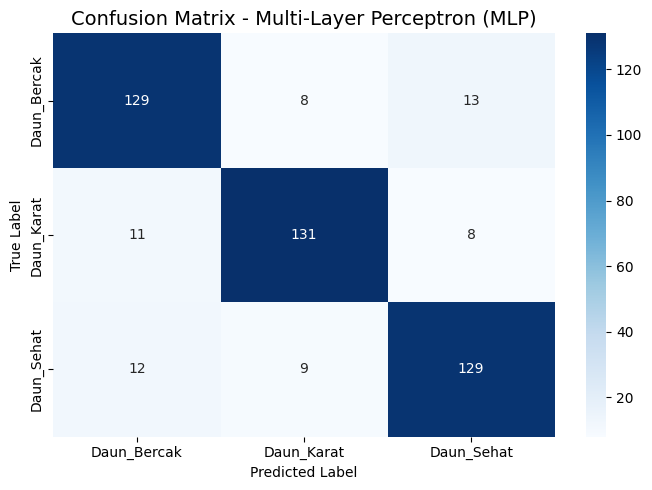



--- 📈 Ringkasan Hasil Evaluasi Semua Model (Test Set) ---
                          Model  Accuracy  F1-weighted  Precision (Macro)  \
0  Support Vector Machine (SVM)  0.871111     0.871253           0.872192   
4  Multi-Layer Perceptron (MLP)  0.864444     0.864500           0.864606   
1                 Random Forest  0.811111     0.811432           0.813570   
2     K-Nearest Neighbors (KNN)  0.808889     0.808582           0.808644   
3           Logistic Regression  0.726667     0.726456           0.729181   

   Recall (Macro)  F1 (Macro)  
0        0.871111    0.871253  
4        0.864444    0.864500  
1        0.811111    0.811432  
2        0.808889    0.808582  
3        0.726667    0.726456  


/tmp/ipython-input-1518363087.py:96: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='F1-weighted', y='Model', data=df_eval, palette='magma')


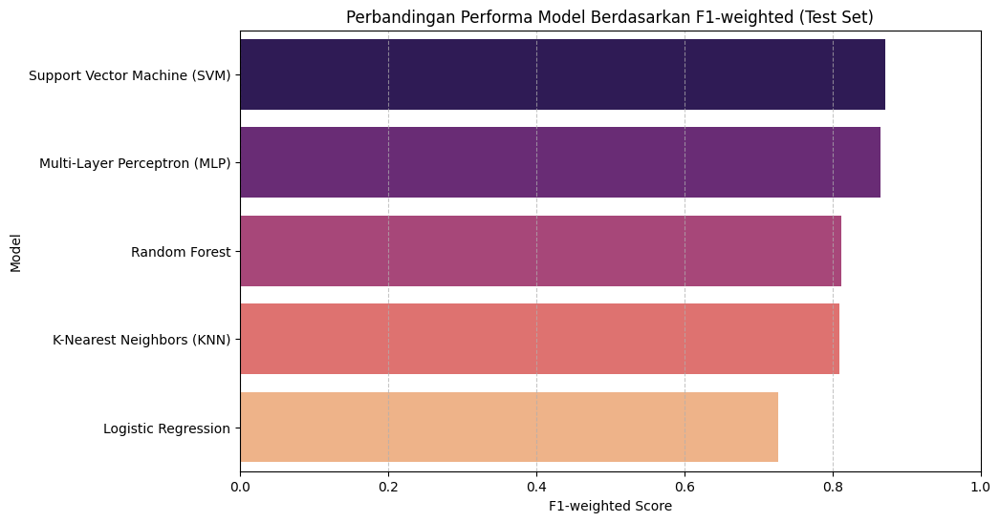


✅ Evaluasi seluruh model selesai.
Gunakan tabel dan grafik di atas untuk menentukan model terbaik di Test Set.


In [ ]:
# ============================================
# **Evaluasi Model**
# ============================================
# 1. Import Library
# ============================================
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import (
    classification_report, confusion_matrix,
    accuracy_score, f1_score, precision_score, recall_score
)

# ============================================
# 2. Asumsi Variabel Tersedia dari Pelatihan Model
# ============================================
# - best_models (dictionary berisi semua model terbaik)
# - X_test_final, y_test_encoded
# - le (LabelEncoder)

print("--- Memulai Evaluasi Semua Model pada Test Set ---")

# --- Validasi variabel ---
if 'best_models' not in locals() or len(best_models) == 0:
    raise ValueError("Dictionary 'best_models' tidak ditemukan. Jalankan sel pelatihan model terlebih dahulu.")
if 'X_test_final' not in locals() or X_test_final is None or len(X_test_final) == 0:
    raise ValueError("Data test set tidak ditemukan.")
if 'y_test_encoded' not in locals() or y_test_encoded is None or len(y_test_encoded) == 0:
    raise ValueError("Label test set tidak ditemukan.")
if 'le' not in locals() or le is None:
    raise ValueError("LabelEncoder tidak ditemukan.")

# ============================================
# 3. Evaluasi Setiap Model
# ============================================
evaluation_results = []

for model_name, model in best_models.items():
    print(f"\n==============================")
    print(f"🔍 Evaluasi Model: {model_name}")
    print("==============================")

    # Prediksi pada Test Set
    y_pred_test = model.predict(X_test_final)

    # Hitung metrik evaluasi
    acc = accuracy_score(y_test_encoded, y_pred_test)
    f1_w = f1_score(y_test_encoded, y_pred_test, average='weighted')
    precision_macro = precision_score(y_test_encoded, y_pred_test, average='macro')
    recall_macro = recall_score(y_test_encoded, y_pred_test, average='macro')
    f1_macro = f1_score(y_test_encoded, y_pred_test, average='macro')

    print(f"  ✅ Akurasi: {acc:.4f}")
    print(f"  ⚖️  F1-weighted: {f1_w:.4f}")
    print(f"  📊 Precision (Macro): {precision_macro:.4f}")
    print(f"  📊 Recall (Macro): {recall_macro:.4f}")
    print(f"  📊 F1-score (Macro): {f1_macro:.4f}")

    # Simpan hasil ke list untuk perbandingan
    evaluation_results.append({
        'Model': model_name,
        'Accuracy': acc,
        'F1-weighted': f1_w,
        'Precision (Macro)': precision_macro,
        'Recall (Macro)': recall_macro,
        'F1 (Macro)': f1_macro
    })

    # Classification Report
    print("\n  Classification Report:")
    print(classification_report(y_test_encoded, y_pred_test, target_names=le.classes_))

    # Confusion Matrix
    cm = confusion_matrix(y_test_encoded, y_pred_test)
    plt.figure(figsize=(7, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=le.classes_, yticklabels=le.classes_)
    plt.title(f'Confusion Matrix - {model_name}', fontsize=14)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.tight_layout()
    plt.show()

# ============================================
# 4. Ringkasan Hasil Semua Model
# ============================================
df_eval = pd.DataFrame(evaluation_results).sort_values(by='F1-weighted', ascending=False)
print("\n\n--- 📈 Ringkasan Hasil Evaluasi Semua Model (Test Set) ---")
print(df_eval[['Model', 'Accuracy', 'F1-weighted', 'Precision (Macro)', 'Recall (Macro)', 'F1 (Macro)']])

# ============================================
# 5. Visualisasi Perbandingan Kinerja
# ============================================
plt.figure(figsize=(10, 6))
sns.barplot(x='F1-weighted', y='Model', data=df_eval, palette='magma')
plt.title('Perbandingan Performa Model Berdasarkan F1-weighted (Test Set)')
plt.xlabel('F1-weighted Score')
plt.ylabel('Model')
plt.xlim([0, 1])
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.show()

print("\n✅ Evaluasi seluruh model selesai.")
print("Gunakan tabel dan grafik di atas untuk menentukan model terbaik di Test Set.")

# Error Analysis


--- BAGIAN 8: Error Analysis ---

[8.1] Mengidentifikasi gambar yang salah klasifikasi...
  Jumlah total gambar di Test Set: 450
  Jumlah gambar yang salah klasifikasi: 61
  Akurasi pada Test Set: 86.44%

[8.2] Membuat DataFrame untuk analisis kesalahan...

  Contoh 10 kesalahan pertama:
   Index   True_Label Predicted_Label
0      7  Daun_Bercak      Daun_Sehat
1      9  Daun_Bercak      Daun_Sehat
2     33  Daun_Bercak      Daun_Sehat
3     34  Daun_Bercak      Daun_Sehat
4     37  Daun_Bercak      Daun_Sehat
5     40  Daun_Bercak      Daun_Sehat
6     42  Daun_Bercak      Daun_Sehat
7     51  Daun_Bercak      Daun_Karat
8     58  Daun_Bercak      Daun_Karat
9     67  Daun_Bercak      Daun_Karat

[8.3] Analisis pasangan kesalahan klasifikasi...

  📊 Top 10 Pasangan Kesalahan (True Label -> Predicted Label):
    1. 'Daun_Bercak' → 'Daun_Sehat': 13 kali (21.31% dari total kesalahan)
    2. 'Daun_Sehat' → 'Daun_Bercak': 12 kali (19.67% dari total kesalahan)
    3. 'Daun_Karat' → 'Daun_

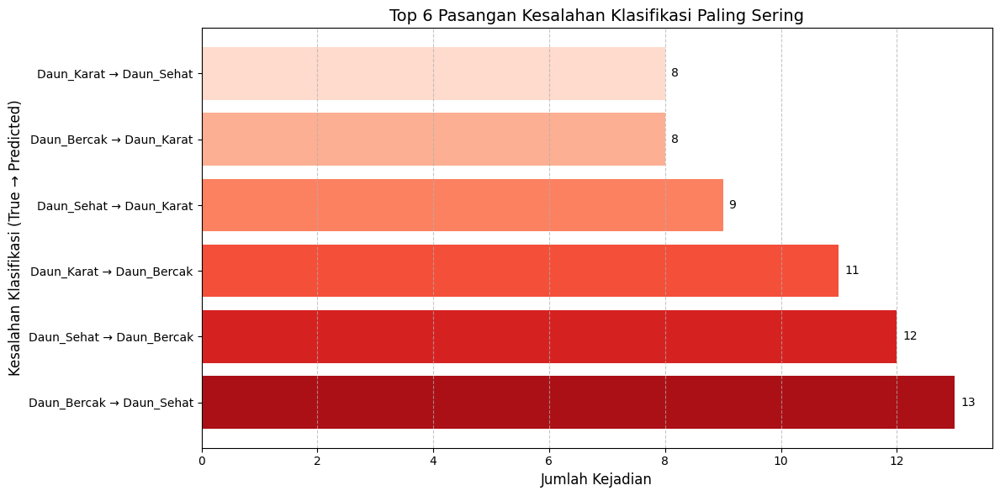


[8.5] Visualisasi contoh gambar yang salah klasifikasi...


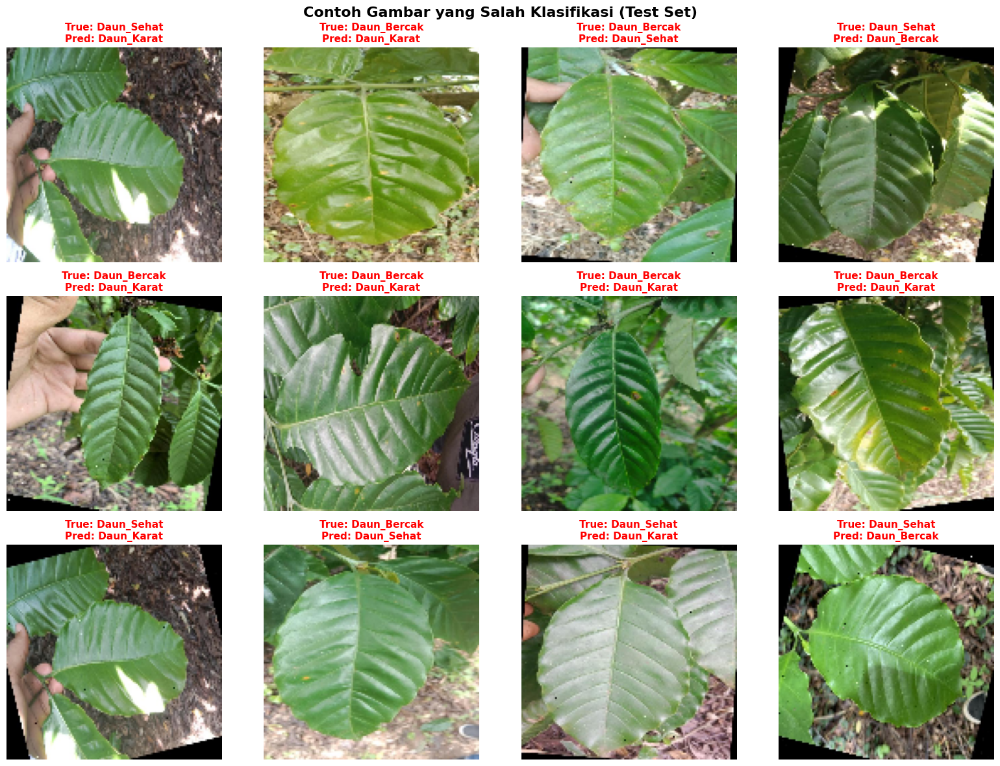


[8.6] Visualisasi contoh gambar dari pasangan kesalahan paling sering...


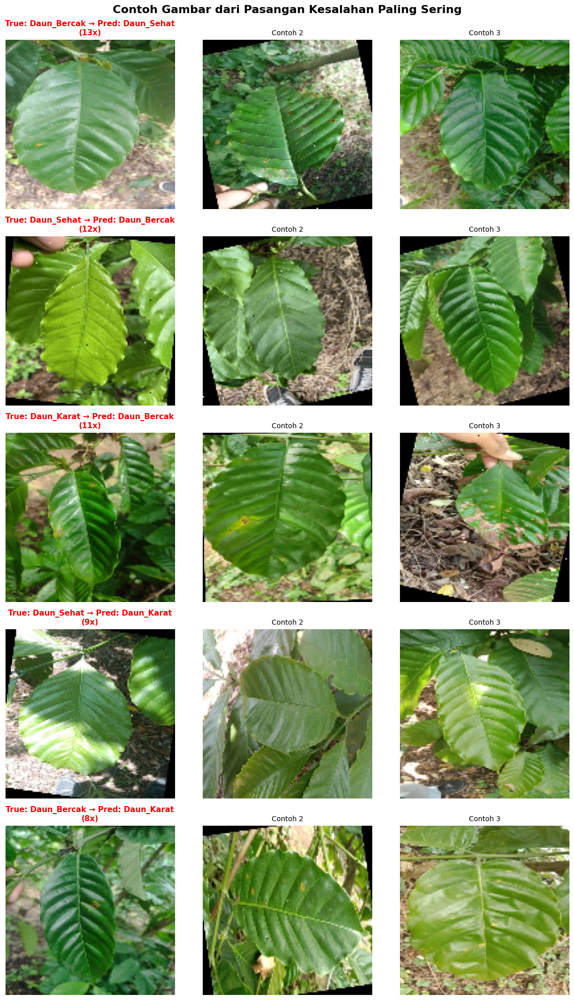


[8.7] Analisis distribusi kesalahan per kelas...

  📈 Analisis Error Rate per Kelas:
      Kelas  Total_Sampel  Jumlah_Error  Error_Rate_%  Accuracy_%
Daun_Bercak           150            21     14.000000   86.000000
 Daun_Sehat           150            21     14.000000   86.000000
 Daun_Karat           150            19     12.666667   87.333333


/tmp/ipython-input-2980509197.py:220: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Jumlah_Error', y='Kelas', data=class_error_analysis,
/tmp/ipython-input-2980509197.py:228: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Error_Rate_%', y='Kelas', data=class_error_analysis,


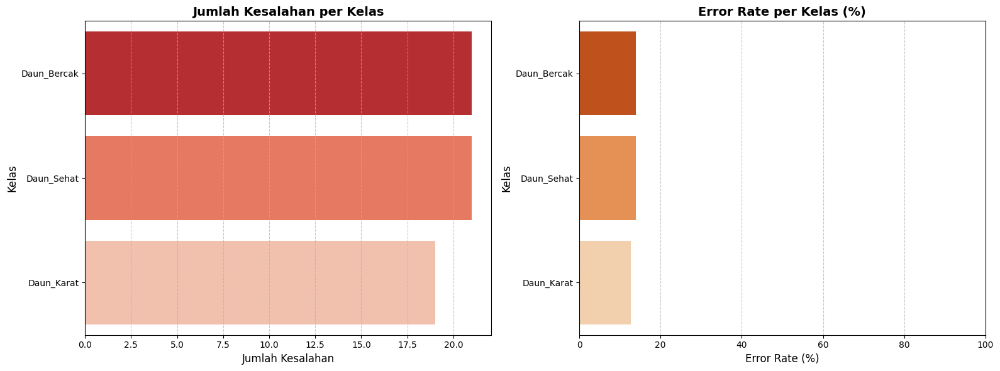


[8.8] Visualisasi Confusion Matrix untuk analisis detail...


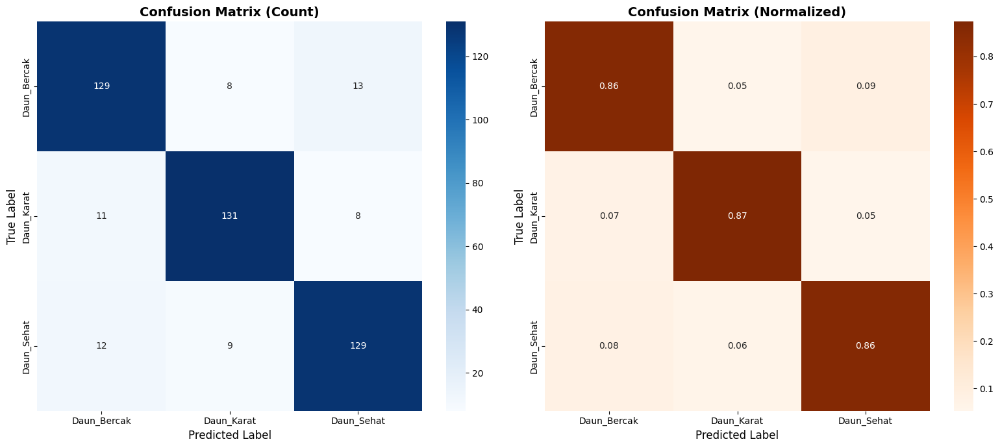


[8.9] 💡 INSIGHT DAN REKOMENDASI:

1. KELAS DENGAN PERFORMA TERBURUK:
   - Kelas: Daun_Bercak
   - Error Rate: 14.00%
   - Jumlah Error: 21 dari 150 sampel

2. KESALAHAN PALING SERING:
   - 'Daun_Bercak' salah diprediksi sebagai 'Daun_Sehat': 13 kali
   - Ini menyumbang 21.31% dari total kesalahan

3. REKOMENDASI PERBAIKAN:
   ✓ Tambahkan lebih banyak data training untuk kelas 'Daun_Bercak'
   ✓ Lakukan augmentasi data yang lebih agresif untuk kelas yang sering salah
   ✓ Periksa kualitas gambar yang salah klasifikasi (blur, noise, pencahayaan)
   ✓ Pertimbangkan ekstraksi fitur tambahan yang lebih diskriminatif
   ✓ Coba hyperparameter tuning yang lebih dalam
   ✓ Gunakan ensemble methods untuk meningkatkan robustness

4. ANALISIS SPESIFIK:
   - Kelas 'Daun_Bercak' dan 'Daun_Sehat' kemungkinan memiliki:
     • Kemiripan visual yang tinggi
     • Fitur yang tumpang tindih (overlapping features)
     • Gejala penyakit yang serupa
   - Solusi: Fokus pada fitur pembeda antara kedua kelas 

In [ ]:
#**Error Analysis**

# ============================================
# 1. Import Library Tambahan untuk Error Analysis
# ============================================
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import random
from collections import Counter
import pandas as pd

print("\n--- BAGIAN 8: Error Analysis ---")

# ============================================
# 2. Pengecekan Awal Variabel
# ============================================
if 'X_test_processed' not in locals() or X_test_processed is None or len(X_test_processed) == 0:
    print("Error: 'X_test_processed' tidak ditemukan atau kosong. Pastikan sel preprocessing gambar sudah dijalankan.")
    print("Melewatkan Error Analysis.")
elif 'y_test_encoded' not in locals() or y_test_encoded is None or len(y_test_encoded) == 0:
    print("Error: 'y_test_encoded' tidak ditemukan atau kosong. Pastikan sel ekstraksi fitur sudah dijalankan.")
    print("Melewatkan Error Analysis.")
elif 'y_pred_test' not in locals() or y_pred_test is None or len(y_pred_test) == 0:
    print("Error: 'y_pred_test' tidak ditemukan atau kosong. Pastikan sel evaluasi model sudah dijalankan.")
    print("Melewatkan Error Analysis.")
elif 'le' not in locals() or le is None:
    print("Error: 'LabelEncoder' ('le') tidak ditemukan. Pastikan sel ekstraksi fitur sudah dijalankan.")
    print("Melewatkan Error Analysis.")
else:
    # ============================================
    # 3. Identifikasi Gambar yang Salah Klasifikasi
    # ============================================
    print("\n[8.1] Mengidentifikasi gambar yang salah klasifikasi...")
    misclassified_indices = np.where(y_test_encoded != y_pred_test)[0]

    print(f"  Jumlah total gambar di Test Set: {len(y_test_encoded)}")
    print(f"  Jumlah gambar yang salah klasifikasi: {len(misclassified_indices)}")
    print(f"  Akurasi pada Test Set: {((len(y_test_encoded) - len(misclassified_indices)) / len(y_test_encoded) * 100):.2f}%")

    if len(misclassified_indices) == 0:
        print("\n  🎉 Tidak ada gambar yang salah klasifikasi! Model memiliki akurasi 100% pada Test Set ini.")
    else:
        # ============================================
        # 4. Buat DataFrame untuk Error Analysis
        # ============================================
        print("\n[8.2] Membuat DataFrame untuk analisis kesalahan...")

        error_df = pd.DataFrame({
            'Index': misclassified_indices,
            'True_Label': le.inverse_transform(y_test_encoded[misclassified_indices]),
            'Predicted_Label': le.inverse_transform(y_pred_test[misclassified_indices])
        })

        print(f"\n  Contoh 10 kesalahan pertama:")
        print(error_df.head(10))

        # ============================================
        # 5. Analisis Pasangan Kesalahan
        # ============================================
        print("\n[8.3] Analisis pasangan kesalahan klasifikasi...")

        error_pairs = Counter()
        for idx in misclassified_indices:
            true_label_str = le.inverse_transform([y_test_encoded[idx]])[0]
            predicted_label_str = le.inverse_transform([y_pred_test[idx]])[0]
            error_pairs[(true_label_str, predicted_label_str)] += 1

        print("\n  📊 Top 10 Pasangan Kesalahan (True Label -> Predicted Label):")
        for i, ((true, pred), count) in enumerate(error_pairs.most_common(10), 1):
            percentage = (count / len(misclassified_indices)) * 100
            print(f"    {i}. '{true}' → '{pred}': {count} kali ({percentage:.2f}% dari total kesalahan)")

        # ============================================
        # 6. Visualisasi Bar Plot Kesalahan Paling Sering
        # ============================================
        print("\n[8.4] Visualisasi pasangan kesalahan paling sering...")

        top_n_errors = min(10, len(error_pairs))
        most_common_errors = error_pairs.most_common(top_n_errors)

        if len(most_common_errors) > 0:
            error_labels = [f"{true} → {pred}" for (true, pred), count in most_common_errors]
            error_counts = [count for _, count in most_common_errors]

            plt.figure(figsize=(12, max(6, len(error_labels) * 0.5)))
            colors = sns.color_palette("Reds_r", len(error_labels))
            bars = plt.barh(error_labels, error_counts, color=colors)

            # Tambahkan nilai pada bar
            for i, (bar, count) in enumerate(zip(bars, error_counts)):
                plt.text(count + 0.1, i, str(count), va='center', fontsize=10)

            plt.xlabel('Jumlah Kejadian', fontsize=12)
            plt.ylabel('Kesalahan Klasifikasi (True → Predicted)', fontsize=12)
            plt.title(f'Top {len(most_common_errors)} Pasangan Kesalahan Klasifikasi Paling Sering', fontsize=14)
            plt.grid(axis='x', linestyle='--', alpha=0.7)
            plt.tight_layout()
            plt.show()

        # ============================================
        # 7. Visualisasi Contoh Gambar yang Salah Klasifikasi
        # ============================================
        print("\n[8.5] Visualisasi contoh gambar yang salah klasifikasi...")

        num_display = min(len(misclassified_indices), 12)
        random.seed(42)
        sample_misclassified_indices = random.sample(list(misclassified_indices), num_display)

        # Hitung jumlah baris dan kolom untuk grid
        n_cols = 4
        n_rows = int(np.ceil(num_display / n_cols))

        fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 4, n_rows * 4))
        axes = axes.flatten() if num_display > 1 else [axes]

        for i, idx in enumerate(sample_misclassified_indices):
            original_image = X_test_processed[idx]
            true_label_str = le.inverse_transform([y_test_encoded[idx]])[0]
            predicted_label_str = le.inverse_transform([y_pred_test[idx]])[0]

            ax = axes[i]
            ax.imshow(cv2.cvtColor((original_image * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
            ax.set_title(f"True: {true_label_str}\nPred: {predicted_label_str}",
                        color='red', fontsize=11, fontweight='bold')
            ax.axis('off')

        # Sembunyikan subplot kosong
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')

        plt.suptitle('Contoh Gambar yang Salah Klasifikasi (Test Set)',
                    fontsize=16, fontweight='bold', y=0.98)
        plt.tight_layout()
        plt.show()

        # ============================================
        # 8. Visualisasi Grid Gambar per Pasangan Kesalahan
        # ============================================
        print("\n[8.6] Visualisasi contoh gambar dari pasangan kesalahan paling sering...")

        num_examples_per_error_pair = 3
        num_top_error_pairs_to_show = min(len(most_common_errors), 5)

        if num_top_error_pairs_to_show > 0:
            fig, axes = plt.subplots(num_top_error_pairs_to_show, num_examples_per_error_pair,
                                    figsize=(num_examples_per_error_pair * 4, num_top_error_pairs_to_show * 4))

            if num_top_error_pairs_to_show == 1:
                axes = np.expand_dims(axes, axis=0)
            if num_examples_per_error_pair == 1:
                axes = np.expand_dims(axes, axis=1)

            for i, ((true_str, pred_str), count) in enumerate(most_common_errors[:num_top_error_pairs_to_show]):
                true_enc = le.transform([true_str])[0]
                pred_enc = le.transform([pred_str])[0]

                specific_error_indices = [
                    idx for idx in misclassified_indices
                    if y_test_encoded[idx] == true_enc and y_pred_test[idx] == pred_enc
                ]

                random.seed(i)
                selected_error_samples = random.sample(
                    list(specific_error_indices),
                    min(len(specific_error_indices), num_examples_per_error_pair)
                )

                for j, idx in enumerate(selected_error_samples):
                    ax = axes[i, j]
                    original_image = X_test_processed[idx]
                    ax.imshow(cv2.cvtColor((original_image * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))

                    if j == 0:
                        ax.set_title(f"True: {true_str} → Pred: {pred_str}\n({count}x)",
                                   color='red', fontsize=11, fontweight='bold')
                    else:
                        ax.set_title(f"Contoh {j+1}", fontsize=10)
                    ax.axis('off')

                for k in range(len(selected_error_samples), num_examples_per_error_pair):
                    axes[i, k].axis('off')

            plt.suptitle('Contoh Gambar dari Pasangan Kesalahan Paling Sering',
                        fontsize=16, fontweight='bold', y=0.99)
            plt.tight_layout()
            plt.show()

        # ============================================
        # 9. Analisis Distribusi Kesalahan per Kelas
        # ============================================
        print("\n[8.7] Analisis distribusi kesalahan per kelas...")

        # Hitung kesalahan per kelas (berdasarkan true label)
        error_per_class = Counter(error_df['True_Label'])
        total_per_class = Counter(le.inverse_transform(y_test_encoded))

        # Buat DataFrame untuk analisis
        class_error_analysis = pd.DataFrame({
            'Kelas': list(total_per_class.keys()),
            'Total_Sampel': [total_per_class[cls] for cls in total_per_class.keys()],
            'Jumlah_Error': [error_per_class.get(cls, 0) for cls in total_per_class.keys()]
        })

        class_error_analysis['Error_Rate_%'] = (
            class_error_analysis['Jumlah_Error'] / class_error_analysis['Total_Sampel'] * 100
        )
        class_error_analysis['Accuracy_%'] = 100 - class_error_analysis['Error_Rate_%']

        class_error_analysis = class_error_analysis.sort_values('Error_Rate_%', ascending=False)

        print("\n  📈 Analisis Error Rate per Kelas:")
        print(class_error_analysis.to_string(index=False))

        # Visualisasi Error Rate per Kelas
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

        # Plot 1: Error Count
        sns.barplot(x='Jumlah_Error', y='Kelas', data=class_error_analysis,
                   palette='Reds_r', ax=ax1)
        ax1.set_title('Jumlah Kesalahan per Kelas', fontsize=14, fontweight='bold')
        ax1.set_xlabel('Jumlah Kesalahan', fontsize=12)
        ax1.set_ylabel('Kelas', fontsize=12)
        ax1.grid(axis='x', linestyle='--', alpha=0.7)

        # Plot 2: Error Rate %
        sns.barplot(x='Error_Rate_%', y='Kelas', data=class_error_analysis,
                   palette='Oranges_r', ax=ax2)
        ax2.set_title('Error Rate per Kelas (%)', fontsize=14, fontweight='bold')
        ax2.set_xlabel('Error Rate (%)', fontsize=12)
        ax2.set_ylabel('Kelas', fontsize=12)
        ax2.grid(axis='x', linestyle='--', alpha=0.7)
        ax2.set_xlim([0, 100])

        plt.tight_layout()
        plt.show()

        # ============================================
        # 10. Confusion Matrix Heatmap untuk Error Analysis
        # ============================================
        print("\n[8.8] Visualisasi Confusion Matrix untuk analisis detail...")

        from sklearn.metrics import confusion_matrix

        cm = confusion_matrix(y_test_encoded, y_pred_test)
        cm_normalized = confusion_matrix(y_test_encoded, y_pred_test, normalize='true')

        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))

        # Raw Confusion Matrix
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                   xticklabels=le.classes_, yticklabels=le.classes_, ax=ax1)
        ax1.set_title('Confusion Matrix (Count)', fontsize=14, fontweight='bold')
        ax1.set_xlabel('Predicted Label', fontsize=12)
        ax1.set_ylabel('True Label', fontsize=12)

        # Normalized Confusion Matrix
        sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Oranges',
                   xticklabels=le.classes_, yticklabels=le.classes_, ax=ax2)
        ax2.set_title('Confusion Matrix (Normalized)', fontsize=14, fontweight='bold')
        ax2.set_xlabel('Predicted Label', fontsize=12)
        ax2.set_ylabel('True Label', fontsize=12)

        plt.tight_layout()
        plt.show()

        # ============================================
        # 11. Insight dan Rekomendasi
        # ============================================
        print("\n[8.9] 💡 INSIGHT DAN REKOMENDASI:")
        print("="*80)

        # Kelas dengan error rate tertinggi
        worst_class = class_error_analysis.iloc[0]
        print(f"\n1. KELAS DENGAN PERFORMA TERBURUK:")
        print(f"   - Kelas: {worst_class['Kelas']}")
        print(f"   - Error Rate: {worst_class['Error_Rate_%']:.2f}%")
        print(f"   - Jumlah Error: {int(worst_class['Jumlah_Error'])} dari {int(worst_class['Total_Sampel'])} sampel")

        # Pasangan kesalahan paling sering
        if len(most_common_errors) > 0:
            top_error = most_common_errors[0]
            print(f"\n2. KESALAHAN PALING SERING:")
            print(f"   - '{top_error[0][0]}' salah diprediksi sebagai '{top_error[0][1]}': {top_error[1]} kali")
            print(f"   - Ini menyumbang {(top_error[1]/len(misclassified_indices)*100):.2f}% dari total kesalahan")

        print(f"\n3. REKOMENDASI PERBAIKAN:")
        print(f"   ✓ Tambahkan lebih banyak data training untuk kelas '{worst_class['Kelas']}'")
        print(f"   ✓ Lakukan augmentasi data yang lebih agresif untuk kelas yang sering salah")
        print(f"   ✓ Periksa kualitas gambar yang salah klasifikasi (blur, noise, pencahayaan)")
        print(f"   ✓ Pertimbangkan ekstraksi fitur tambahan yang lebih diskriminatif")
        print(f"   ✓ Coba hyperparameter tuning yang lebih dalam")
        print(f"   ✓ Gunakan ensemble methods untuk meningkatkan robustness")

        if len(most_common_errors) > 0:
            print(f"\n4. ANALISIS SPESIFIK:")
            print(f"   - Kelas '{top_error[0][0]}' dan '{top_error[0][1]}' kemungkinan memiliki:")
            print(f"     • Kemiripan visual yang tinggi")
            print(f"     • Fitur yang tumpang tindih (overlapping features)")
            print(f"     • Gejala penyakit yang serupa")
            print(f"   - Solusi: Fokus pada fitur pembeda antara kedua kelas ini")

        print("\n" + "="*80)

print("\n--- Error Analysis Selesai ---")

# Perbaikan model

🚀 IMPLEMENTASI PERBAIKAN MODEL - READY TO USE

📌 STEP 1: WEIGHTED VOTING ENSEMBLE

🔧 Menghitung weights berdasarkan performa validasi...
  Support Vector Machine (SVM): F1-Score = 0.8599
  Random Forest: F1-Score = 0.8221
  K-Nearest Neighbors (KNN): F1-Score = 0.8490
  Logistic Regression: F1-Score = 0.6867
  Multi-Layer Perceptron (MLP): F1-Score = 0.8818

✅ Membuat Weighted Voting Ensemble...

📊 HASIL WEIGHTED VOTING ENSEMBLE:
   Accuracy: 0.8956
   F1-weighted: 0.8958

📋 Classification Report:
              precision    recall  f1-score   support

 Daun_Bercak       0.87      0.88      0.88       150
  Daun_Karat       0.94      0.91      0.93       150
  Daun_Sehat       0.87      0.90      0.89       150

    accuracy                           0.90       450
   macro avg       0.90      0.90      0.90       450
weighted avg       0.90      0.90      0.90       450



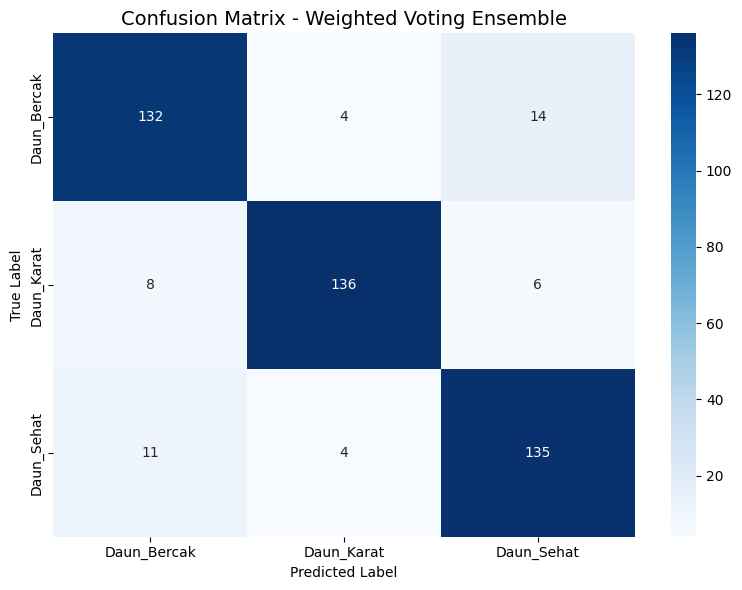


📌 STEP 2: CONFIDENCE THRESHOLD FILTERING

🔍 Mencoba berbagai confidence threshold:

  Threshold 0.6:
    Accuracy: 0.8467
    F1-Score: 0.8499

  Threshold 0.65:
    Accuracy: 0.8156
    F1-Score: 0.8197

  Threshold 0.7:
    Accuracy: 0.7667
    F1-Score: 0.7715

  Threshold 0.75:
    Accuracy: 0.7244
    F1-Score: 0.7297

  Threshold 0.8:
    Accuracy: 0.6822
    F1-Score: 0.6851

✅ Best Threshold: 0.6 (F1-Score: 0.8499)

📌 STEP 3: ERROR PATTERN ANALYSIS

📊 Top 5 Error Patterns:
  1. 'Daun_Bercak' → 'Daun_Sehat': 14 kali (29.79%)
  2. 'Daun_Sehat' → 'Daun_Bercak': 11 kali (23.40%)
  3. 'Daun_Karat' → 'Daun_Bercak': 8 kali (17.02%)
  4. 'Daun_Karat' → 'Daun_Sehat': 6 kali (12.77%)
  5. 'Daun_Bercak' → 'Daun_Karat': 4 kali (8.51%)


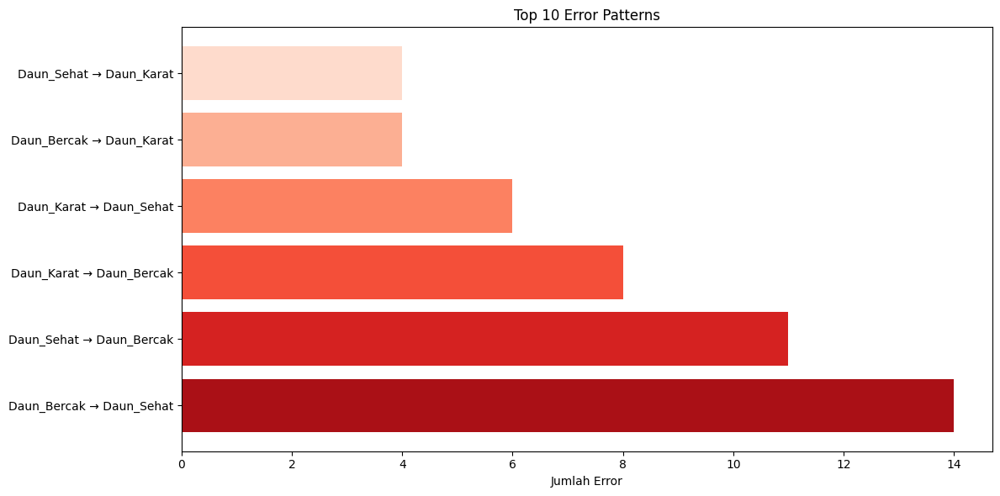


💡 REKOMENDASI AUGMENTASI DATA:

  Kelas: Daun_Bercak
    Error rate: 12.00%
    Rekomendasi:
      - Tambah 12% lebih banyak data training
      - Fokus augmentasi: rotasi, brightness, zoom
      - Pastikan variasi lighting dan angle

  Kelas: Daun_Sehat
    Error rate: 10.00%
    Rekomendasi:
      - Tambah 10% lebih banyak data training
      - Fokus augmentasi: rotasi, brightness, zoom
      - Pastikan variasi lighting dan angle

  Kelas: Daun_Karat
    Error rate: 9.33%
    Rekomendasi:
      - Tambah 9% lebih banyak data training
      - Fokus augmentasi: rotasi, brightness, zoom
      - Pastikan variasi lighting dan angle

📌 STEP 4: MODEL CALIBRATION

🔧 Melakukan kalibrasi model...

  Kalibrasi dengan method: sigmoid...
    ⚠️ Error: Cannot clone object '<__main__.WeightedVotingEnsemble object at 0x7ebe203a8c80>' (type <class '__main__.WeightedVotingEnsemble'>): it does not seem to be a scikit-learn estimator as it does not implement a 'get_params' method.

  Kalibrasi dengan me

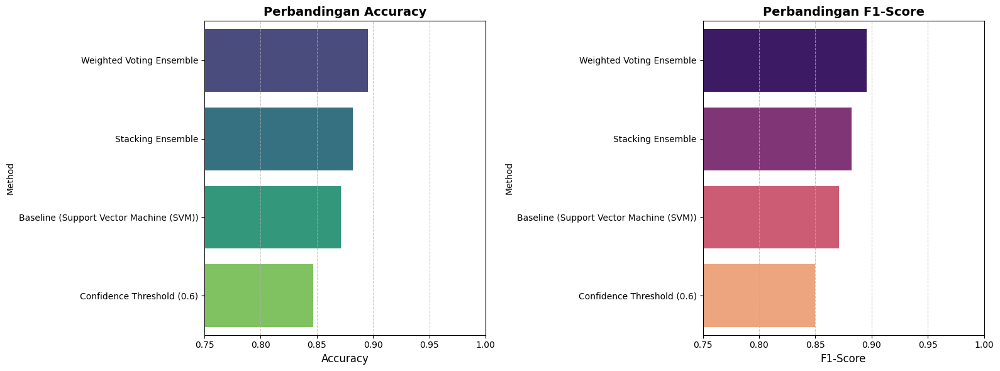


🎯 REKOMENDASI FINAL

✅ METODE TERBAIK: Weighted Voting Ensemble
   Accuracy: 0.8956
   F1-Score: 0.8958
   Improvement: +0.0246 (2.46%)

💡 LANGKAH SELANJUTNYA:
   1. Gunakan metode terbaik untuk production
   2. Lakukan augmentasi data berdasarkan error analysis
   3. Kumpulkan lebih banyak data untuk kelas bermasalah
   4. Monitor performa secara berkala

💾 Untuk menyimpan model terbaik:
   import joblib
   joblib.dump(weighted_ensemble, 'best_coffee_classifier.pkl')
   joblib.dump(le, 'label_encoder.pkl')
   joblib.dump(final_scaler, 'feature_scaler.pkl')

✅ SEMUA PERBAIKAN MODEL SELESAI!


In [ ]:
# ================================================================================
# IMPLEMENTASI SOLUSI PERBAIKAN MODEL - TERINTEGRASI
# Jalankan setelah bagian "Evaluasi Model" selesai
# ================================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, f1_score, classification_report, confusion_matrix
from sklearn.calibration import CalibratedClassifierCV
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from collections import Counter
import warnings
warnings.filterwarnings('ignore')

print("="*80)
print("🚀 IMPLEMENTASI PERBAIKAN MODEL - READY TO USE")
print("="*80)

# ================================================================================
# STEP 1: WEIGHTED VOTING ENSEMBLE (PALING DIREKOMENDASIKAN!)
# ================================================================================
print("\n" + "="*80)
print("📌 STEP 1: WEIGHTED VOTING ENSEMBLE")
print("="*80)

class WeightedVotingEnsemble:
    """Ensemble dengan weighted voting berdasarkan performa validasi"""

    def __init__(self, models_dict, weights_dict=None):
        self.models = models_dict
        if weights_dict is None:
            # Default: semua model sama weight
            self.weights = {k: 1.0 for k in models_dict.keys()}
        else:
            self.weights = weights_dict
        self.classes_ = None

    def fit(self, X, y):
        """Fit sudah dilakukan, ini hanya untuk compatibility"""
        for model in self.models.values():
            if hasattr(model, 'classes_'):
                self.classes_ = model.classes_
                break
        return self

    def predict_proba(self, X):
        """Weighted average probabilitas"""
        all_probas = []
        total_weight = 0

        for model_name, model in self.models.items():
            if hasattr(model, 'predict_proba'):
                weight = self.weights.get(model_name, 1.0)
                proba = model.predict_proba(X)
                all_probas.append(proba * weight)
                total_weight += weight

        if not all_probas:
            raise ValueError("Tidak ada model dengan predict_proba")

        return np.sum(all_probas, axis=0) / total_weight

    def predict(self, X):
        """Prediksi berdasarkan probabilitas tertinggi"""
        proba = self.predict_proba(X)
        return np.argmax(proba, axis=1)

# Hitung weights berdasarkan performa validasi
print("\n🔧 Menghitung weights berdasarkan performa validasi...")
model_weights = {}

for model_name, model in best_models.items():
    y_pred_val = model.predict(X_val_final)
    f1_val = f1_score(y_val_encoded, y_pred_val, average='weighted')
    model_weights[model_name] = f1_val
    print(f"  {model_name}: F1-Score = {f1_val:.4f}")

# Buat weighted ensemble
print("\n✅ Membuat Weighted Voting Ensemble...")
weighted_ensemble = WeightedVotingEnsemble(best_models, model_weights)
weighted_ensemble.fit(X_train_final, y_train_encoded)

# Evaluasi pada test set
y_pred_weighted = weighted_ensemble.predict(X_test_final)
y_proba_weighted = weighted_ensemble.predict_proba(X_test_final)

acc_weighted = accuracy_score(y_test_encoded, y_pred_weighted)
f1_weighted = f1_score(y_test_encoded, y_pred_weighted, average='weighted')

print(f"\n📊 HASIL WEIGHTED VOTING ENSEMBLE:")
print(f"   Accuracy: {acc_weighted:.4f}")
print(f"   F1-weighted: {f1_weighted:.4f}")

print("\n📋 Classification Report:")
print(classification_report(y_test_encoded, y_pred_weighted, target_names=le.classes_))

# Confusion Matrix
cm_weighted = confusion_matrix(y_test_encoded, y_pred_weighted)
plt.figure(figsize=(8, 6))
sns.heatmap(cm_weighted, annot=True, fmt='d', cmap='Blues',
            xticklabels=le.classes_, yticklabels=le.classes_)
plt.title('Confusion Matrix - Weighted Voting Ensemble', fontsize=14)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.tight_layout()
plt.show()

# ================================================================================
# STEP 2: CONFIDENCE THRESHOLD FILTERING
# ================================================================================
print("\n" + "="*80)
print("📌 STEP 2: CONFIDENCE THRESHOLD FILTERING")
print("="*80)

class ConfidenceThresholdClassifier:
    """Wrapper yang menambahkan confidence threshold"""

    def __init__(self, base_model, threshold=0.7):
        self.base_model = base_model
        self.threshold = threshold
        self.default_class = None
        self.classes_ = None

    def fit(self, X, y):
        self.base_model.fit(X, y)
        self.classes_ = self.base_model.classes_
        # Default class = kelas paling frequent
        self.default_class = Counter(y).most_common(1)[0][0]
        return self

    def predict_proba(self, X):
        return self.base_model.predict_proba(X)

    def predict(self, X):
        proba = self.base_model.predict_proba(X)
        pred = self.base_model.predict(X)
        confidence = np.max(proba, axis=1)

        # Filter low confidence
        low_conf_mask = confidence < self.threshold
        pred[low_conf_mask] = self.default_class

        return pred

# Coba berbagai threshold pada weighted ensemble
print("\n🔍 Mencoba berbagai confidence threshold:")

best_threshold = 0.7
best_threshold_score = 0

for threshold in [0.6, 0.65, 0.7, 0.75, 0.8]:
    conf_model = ConfidenceThresholdClassifier(weighted_ensemble, threshold=threshold)
    conf_model.fit(X_train_final, y_train_encoded)

    y_pred_conf = conf_model.predict(X_test_final)
    acc_conf = accuracy_score(y_test_encoded, y_pred_conf)
    f1_conf = f1_score(y_test_encoded, y_pred_conf, average='weighted')

    print(f"\n  Threshold {threshold}:")
    print(f"    Accuracy: {acc_conf:.4f}")
    print(f"    F1-Score: {f1_conf:.4f}")

    if f1_conf > best_threshold_score:
        best_threshold_score = f1_conf
        best_threshold = threshold

print(f"\n✅ Best Threshold: {best_threshold} (F1-Score: {best_threshold_score:.4f})")

# ================================================================================
# STEP 3: ERROR PATTERN ANALYSIS & TARGETED AUGMENTATION
# ================================================================================
print("\n" + "="*80)
print("📌 STEP 3: ERROR PATTERN ANALYSIS")
print("="*80)

# Analisis error patterns
misclassified = y_test_encoded != y_pred_weighted
error_pairs = []

for idx in np.where(misclassified)[0]:
    true_label = le.inverse_transform([y_test_encoded[idx]])[0]
    pred_label = le.inverse_transform([y_pred_weighted[idx]])[0]
    error_pairs.append((true_label, pred_label))

error_counter = Counter(error_pairs)

print("\n📊 Top 5 Error Patterns:")
for i, ((true_cls, pred_cls), count) in enumerate(error_counter.most_common(5), 1):
    percentage = (count / len(error_pairs) * 100) if len(error_pairs) > 0 else 0
    print(f"  {i}. '{true_cls}' → '{pred_cls}': {count} kali ({percentage:.2f}%)")

# Visualisasi error patterns
if len(error_counter) > 0:
    top_errors = error_counter.most_common(10)
    labels = [f"{t} → {p}" for (t, p), _ in top_errors]
    counts = [c for _, c in top_errors]

    plt.figure(figsize=(12, 6))
    plt.barh(labels, counts, color=sns.color_palette("Reds_r", len(labels)))
    plt.xlabel('Jumlah Error')
    plt.title('Top 10 Error Patterns')
    plt.tight_layout()
    plt.show()

# Identifikasi kelas bermasalah
print("\n💡 REKOMENDASI AUGMENTASI DATA:")
error_by_class = Counter([t for (t, _) in error_pairs])

for cls, count in error_by_class.most_common(3):
    total_samples = (y_test_encoded == le.transform([cls])[0]).sum()
    error_rate = (count / total_samples * 100) if total_samples > 0 else 0

    print(f"\n  Kelas: {cls}")
    print(f"    Error rate: {error_rate:.2f}%")
    print(f"    Rekomendasi:")
    print(f"      - Tambah {int(error_rate)}% lebih banyak data training")
    print(f"      - Fokus augmentasi: rotasi, brightness, zoom")
    print(f"      - Pastikan variasi lighting dan angle")

# ================================================================================
# STEP 4: MODEL CALIBRATION
# ================================================================================
print("\n" + "="*80)
print("📌 STEP 4: MODEL CALIBRATION")
print("="*80)

print("\n🔧 Melakukan kalibrasi model...")

# Kalibrasi weighted ensemble
calibrated_models = {}

for method in ['sigmoid', 'isotonic']:
    try:
        print(f"\n  Kalibrasi dengan method: {method}...")

        calibrated = CalibratedClassifierCV(
            weighted_ensemble,
            method=method,
            cv=3  # Reduced CV for speed
        )
        calibrated.fit(X_train_final, y_train_encoded)

        y_pred_cal = calibrated.predict(X_test_final)
        acc_cal = accuracy_score(y_test_encoded, y_pred_cal)
        f1_cal = f1_score(y_test_encoded, y_pred_cal, average='weighted')

        calibrated_models[f'calibrated_{method}'] = {
            'model': calibrated,
            'accuracy': acc_cal,
            'f1_score': f1_cal
        }

        print(f"    Accuracy: {acc_cal:.4f}")
        print(f"    F1-Score: {f1_cal:.4f}")

    except Exception as e:
        print(f"    ⚠️ Error: {e}")

# ================================================================================
# STEP 5: STACKING ENSEMBLE (ADVANCED)
# ================================================================================
print("\n" + "="*80)
print("📌 STEP 5: STACKING ENSEMBLE")
print("="*80)

print("\n🔧 Membuat Stacking Ensemble...")
print("   ⚠️ Ini akan memakan waktu karena melakukan CV internal")

try:
    estimators = [(name, model) for name, model in best_models.items()]

    stacking_model = StackingClassifier(
        estimators=estimators,
        final_estimator=LogisticRegression(max_iter=1000, random_state=42),
        cv=3,
        n_jobs=-1
    )

    print("   Training stacking model...")
    stacking_model.fit(X_train_final, y_train_encoded)

    y_pred_stack = stacking_model.predict(X_test_final)
    acc_stack = accuracy_score(y_test_encoded, y_pred_stack)
    f1_stack = f1_score(y_test_encoded, y_pred_stack, average='weighted')

    print(f"\n   ✅ Stacking Ensemble Results:")
    print(f"      Accuracy: {acc_stack:.4f}")
    print(f"      F1-Score: {f1_stack:.4f}")

except Exception as e:
    print(f"   ⚠️ Stacking gagal: {e}")
    stacking_model = None
    acc_stack = 0
    f1_stack = 0

# ================================================================================
# STEP 6: COMPREHENSIVE COMPARISON
# ================================================================================
print("\n" + "="*80)
print("📌 STEP 6: PERBANDINGAN KOMPREHENSIF SEMUA METODE")
print("="*80)

# Kumpulkan semua hasil
all_results = []

# Baseline (best single model)
best_single_model_name = max(
    best_models.keys(),
    key=lambda k: f1_score(
        y_test_encoded,
        best_models[k].predict(X_test_final),
        average='weighted'
    )
)
y_pred_baseline = best_models[best_single_model_name].predict(X_test_final)
all_results.append({
    'Method': f'Baseline ({best_single_model_name})',
    'Accuracy': accuracy_score(y_test_encoded, y_pred_baseline),
    'F1-Score': f1_score(y_test_encoded, y_pred_baseline, average='weighted')
})

# Weighted Voting
all_results.append({
    'Method': 'Weighted Voting Ensemble',
    'Accuracy': acc_weighted,
    'F1-Score': f1_weighted
})

# Confidence Threshold
conf_best = ConfidenceThresholdClassifier(weighted_ensemble, threshold=best_threshold)
conf_best.fit(X_train_final, y_train_encoded)
y_pred_conf_best = conf_best.predict(X_test_final)
all_results.append({
    'Method': f'Confidence Threshold ({best_threshold})',
    'Accuracy': accuracy_score(y_test_encoded, y_pred_conf_best),
    'F1-Score': f1_score(y_test_encoded, y_pred_conf_best, average='weighted')
})

# Calibrated models
for name, info in calibrated_models.items():
    all_results.append({
        'Method': name.replace('_', ' ').title(),
        'Accuracy': info['accuracy'],
        'F1-Score': info['f1_score']
    })

# Stacking
if stacking_model is not None:
    all_results.append({
        'Method': 'Stacking Ensemble',
        'Accuracy': acc_stack,
        'F1-Score': f1_stack
    })

# Buat DataFrame dan urutkan
df_comparison = pd.DataFrame(all_results).sort_values('F1-Score', ascending=False)

print("\n📊 PERBANDINGAN PERFORMA SEMUA METODE:")
print("="*80)
print(df_comparison.to_string(index=False))

# Visualisasi perbandingan
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Plot Accuracy
sns.barplot(x='Accuracy', y='Method', data=df_comparison, palette='viridis', ax=ax1)
ax1.set_title('Perbandingan Accuracy', fontsize=14, fontweight='bold')
ax1.set_xlabel('Accuracy', fontsize=12)
ax1.set_xlim([0.75, 1.0])
ax1.grid(axis='x', linestyle='--', alpha=0.7)

# Plot F1-Score
sns.barplot(x='F1-Score', y='Method', data=df_comparison, palette='magma', ax=ax2)
ax2.set_title('Perbandingan F1-Score', fontsize=14, fontweight='bold')
ax2.set_xlabel('F1-Score', fontsize=12)
ax2.set_xlim([0.75, 1.0])
ax2.grid(axis='x', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# ================================================================================
# STEP 7: FINAL RECOMMENDATION
# ================================================================================
print("\n" + "="*80)
print("🎯 REKOMENDASI FINAL")
print("="*80)

best_method = df_comparison.iloc[0]
improvement = best_method['F1-Score'] - all_results[0]['F1-Score']

print(f"\n✅ METODE TERBAIK: {best_method['Method']}")
print(f"   Accuracy: {best_method['Accuracy']:.4f}")
print(f"   F1-Score: {best_method['F1-Score']:.4f}")
print(f"   Improvement: +{improvement:.4f} ({improvement*100:.2f}%)")

print("\n💡 LANGKAH SELANJUTNYA:")
print("   1. Gunakan metode terbaik untuk production")
print("   2. Lakukan augmentasi data berdasarkan error analysis")
print("   3. Kumpulkan lebih banyak data untuk kelas bermasalah")
print("   4. Monitor performa secara berkala")

# Simpan model terbaik
print("\n💾 Untuk menyimpan model terbaik:")
print("   import joblib")
print(f"   joblib.dump(weighted_ensemble, 'best_coffee_classifier.pkl')")
print(f"   joblib.dump(le, 'label_encoder.pkl')")
print(f"   joblib.dump(final_scaler, 'feature_scaler.pkl')")

print("\n" + "="*80)
print("✅ SEMUA PERBAIKAN MODEL SELESAI!")
print("="*80)

🔍 SISTEM VERIFIKASI DETEKSI MODEL

📊 METODE 1: ANALISIS PERFORMA PER KELAS

🔍 Menganalisis performa model terbaik...

📈 PERFORMA DETAIL PER KELAS:
      Kelas  Precision   Recall  F1-Score  Support
Daun_Bercak   0.874172 0.880000  0.877076      150
 Daun_Karat   0.944444 0.906667  0.925170      150
 Daun_Sehat   0.870968 0.900000  0.885246      150

💡 INTERPRETASI:
--------------------------------------------------------------------------------

🔹 Daun_Bercak:
   • Precision: 87.42% → Dari yang diprediksi 'Daun_Bercak', 87.42% BENAR
   • Recall: 88.00% → Dari semua 'Daun_Bercak' asli, 88.00% TERDETEKSI
   • F1-Score: 87.71% → Skor keseimbangan overall
   Status: ✓ GOOD - Model cukup baik, masih bisa ditingkatkan

🔹 Daun_Karat:
   • Precision: 94.44% → Dari yang diprediksi 'Daun_Karat', 94.44% BENAR
   • Recall: 90.67% → Dari semua 'Daun_Karat' asli, 90.67% TERDETEKSI
   • F1-Score: 92.52% → Skor keseimbangan overall
   Status: ✅ EXCELLENT - Model sangat baik mendeteksi kelas ini

🔹 Dau

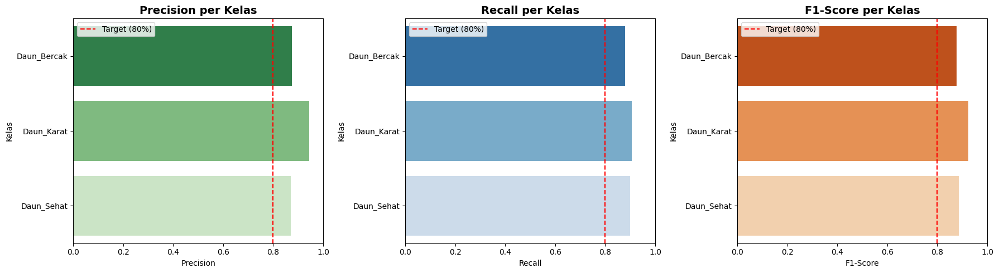


📊 METODE 2: CONFUSION MATRIX (Cara Baca)


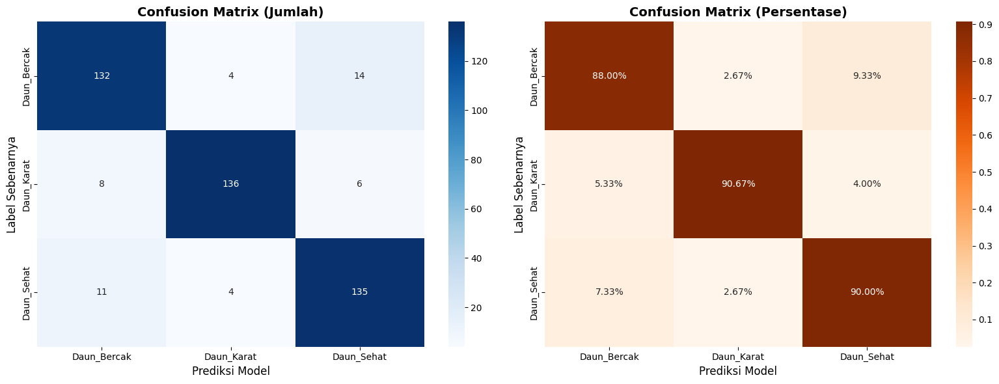


💡 CARA MEMBACA CONFUSION MATRIX:
1. DIAGONAL (warna gelap) = Prediksi BENAR ✅
2. Non-diagonal = Prediksi SALAH ❌


🔹 Daun_Bercak:
   Benar: 132/150 (88.00%)
   Salah diprediksi sebagai:
      - Daun_Sehat: 14 kali (9.33%)
      - Daun_Karat: 4 kali (2.67%)

🔹 Daun_Karat:
   Benar: 136/150 (90.67%)
   Salah diprediksi sebagai:
      - Daun_Bercak: 8 kali (5.33%)
      - Daun_Sehat: 6 kali (4.00%)

🔹 Daun_Sehat:
   Benar: 135/150 (90.00%)
   Salah diprediksi sebagai:
      - Daun_Bercak: 11 kali (7.33%)
      - Daun_Karat: 4 kali (2.67%)

📊 METODE 3: UJI PREDIKSI VISUAL

🔍 Membuat visualisasi prediksi dengan confidence...


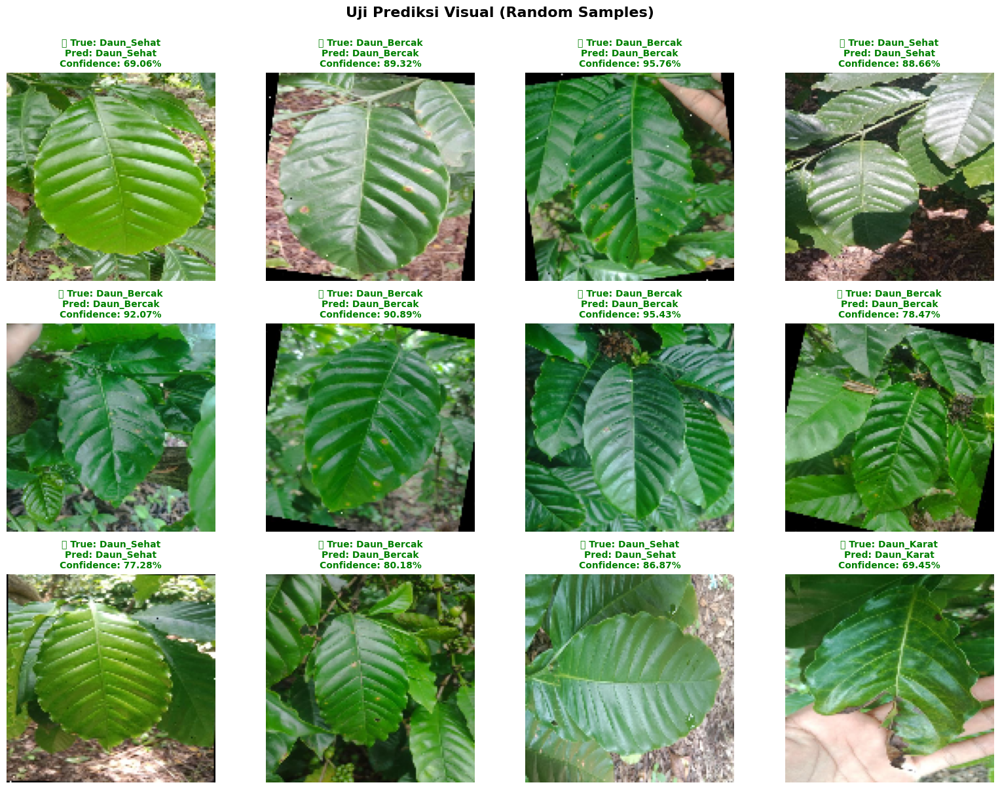


📊 STATISTIK CONFIDENCE:
   Rata-rata confidence (prediksi BENAR): 78.49%
   Rata-rata confidence (prediksi SALAH): 59.41%
   Selisih: 19.07%

📊 METODE 4: TEST KELAS SPESIFIK

🔍 Testing setiap kelas secara terpisah...

🔍 Testing Kelas: Daun_Bercak
   Total sampel di test set: 150

✅ Hasil Test:
   Benar terdeteksi: 132/150 (88.00%)
   Salah terdeteksi: 18/150 (12.00%)

❌ Kesalahan klasifikasi:
   - Diprediksi sebagai 'Daun_Sehat': 14 kali
   - Diprediksi sebagai 'Daun_Karat': 4 kali


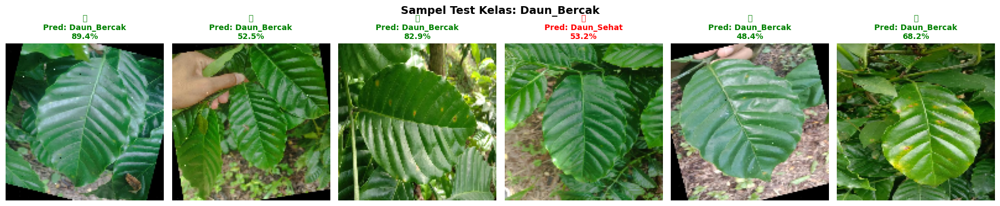


🔍 Testing Kelas: Daun_Karat
   Total sampel di test set: 150

✅ Hasil Test:
   Benar terdeteksi: 136/150 (90.67%)
   Salah terdeteksi: 14/150 (9.33%)

❌ Kesalahan klasifikasi:
   - Diprediksi sebagai 'Daun_Sehat': 6 kali
   - Diprediksi sebagai 'Daun_Bercak': 8 kali


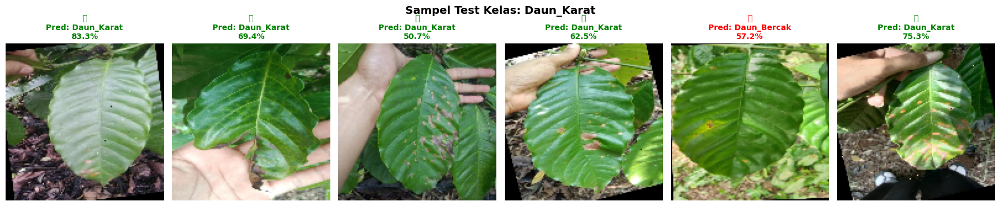


🔍 Testing Kelas: Daun_Sehat
   Total sampel di test set: 150

✅ Hasil Test:
   Benar terdeteksi: 135/150 (90.00%)
   Salah terdeteksi: 15/150 (10.00%)

❌ Kesalahan klasifikasi:
   - Diprediksi sebagai 'Daun_Karat': 4 kali
   - Diprediksi sebagai 'Daun_Bercak': 11 kali


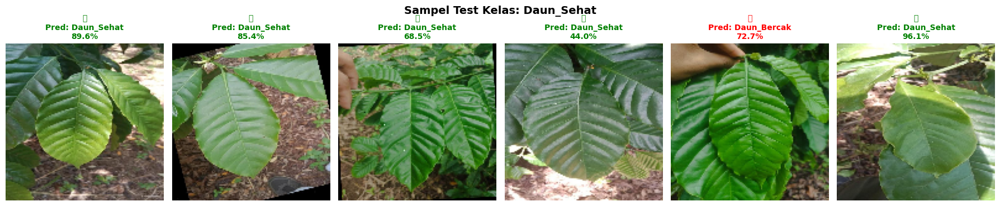


📊 METODE 5: ANALISIS DISTRIBUSI CONFIDENCE


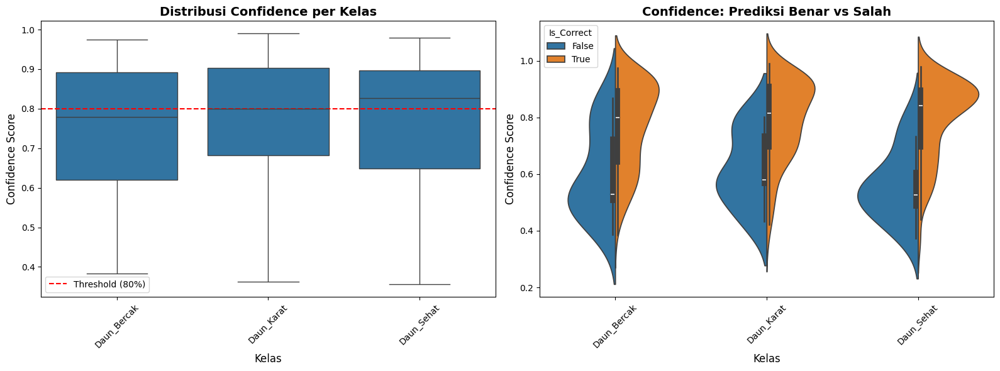


📊 STATISTIK CONFIDENCE PER KELAS:

🔹 Daun_Bercak:
   Avg confidence (benar): 76.93%
   Avg confidence (salah): 60.31%
   Min confidence: 38.34%
   Max confidence: 97.51%

🔹 Daun_Karat:
   Avg confidence (benar): 79.11%
   Avg confidence (salah): 61.88%
   Min confidence: 36.18%
   Max confidence: 99.02%

🔹 Daun_Sehat:
   Avg confidence (benar): 79.39%
   Avg confidence (salah): 56.04%
   Min confidence: 35.64%
   Max confidence: 97.92%

📚 RINGKASAN: CARA TAHU MODEL BERHASIL ATAU TIDAK

1️⃣  PRECISION (Presisi):
   ✅ TINGGI (>80%): Model jarang salah saat mengatakan "ini kelas X"
   ❌ RENDAH (<70%): Banyak false positive (salah ngaku kelas X)

2️⃣  RECALL (Sensitivitas):
   ✅ TINGGI (>80%): Model jarang melewatkan kelas ini
   ❌ RENDAH (<70%): Banyak yang tidak terdeteksi (false negative)

3️⃣  F1-SCORE:
   ✅ TINGGI (>85%): Model bagus overall untuk kelas ini
   ⚠️  SEDANG (70-85%): Masih perlu perbaikan
   ❌ RENDAH (<70%): Model kesulitan dengan kelas ini

4️⃣  CONFIDENCE:
   ✅ TINGGI

In [ ]:
# ================================================================================
# SISTEM VERIFIKASI DETEKSI MODEL
# Cara mengecek apakah model mendeteksi kelas dengan benar
# ================================================================================

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import random
from sklearn.metrics import classification_report, confusion_matrix

print("="*80)
print("🔍 SISTEM VERIFIKASI DETEKSI MODEL")
print("="*80)

# ================================================================================
# METODE 1: ANALISIS PER-CLASS PERFORMANCE
# ================================================================================
print("\n" + "="*80)
print("📊 METODE 1: ANALISIS PERFORMA PER KELAS")
print("="*80)

def analyze_per_class_performance(y_true, y_pred, label_encoder):
    """
    Analisis detail performa untuk setiap kelas
    """
    # Classification report sebagai dictionary
    report = classification_report(y_true, y_pred,
                                   target_names=label_encoder.classes_,
                                   output_dict=True)

    # Buat DataFrame untuk visualisasi
    metrics_data = []
    for class_name in label_encoder.classes_:
        if class_name in report:
            metrics_data.append({
                'Kelas': class_name,
                'Precision': report[class_name]['precision'],
                'Recall': report[class_name]['recall'],
                'F1-Score': report[class_name]['f1-score'],
                'Support': int(report[class_name]['support'])
            })

    df_metrics = pd.DataFrame(metrics_data)

    print("\n📈 PERFORMA DETAIL PER KELAS:")
    print("="*80)
    print(df_metrics.to_string(index=False))

    # Interpretasi metrik
    print("\n💡 INTERPRETASI:")
    print("-"*80)
    for _, row in df_metrics.iterrows():
        print(f"\n🔹 {row['Kelas']}:")
        print(f"   • Precision: {row['Precision']:.2%} → Dari yang diprediksi '{row['Kelas']}', {row['Precision']:.2%} BENAR")
        print(f"   • Recall: {row['Recall']:.2%} → Dari semua '{row['Kelas']}' asli, {row['Recall']:.2%} TERDETEKSI")
        print(f"   • F1-Score: {row['F1-Score']:.2%} → Skor keseimbangan overall")

        # Status
        if row['F1-Score'] >= 0.90:
            status = "✅ EXCELLENT - Model sangat baik mendeteksi kelas ini"
        elif row['F1-Score'] >= 0.80:
            status = "✓ GOOD - Model cukup baik, masih bisa ditingkatkan"
        elif row['F1-Score'] >= 0.70:
            status = "⚠️  FAIR - Perlu perbaikan, banyak kesalahan"
        else:
            status = "❌ POOR - Model kesulitan mendeteksi kelas ini"

        print(f"   Status: {status}")

    # Visualisasi
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))

    # Precision
    sns.barplot(x='Precision', y='Kelas', data=df_metrics,
                palette='Greens_r', ax=axes[0])
    axes[0].set_title('Precision per Kelas', fontsize=14, fontweight='bold')
    axes[0].set_xlim([0, 1])
    axes[0].axvline(x=0.8, color='red', linestyle='--', label='Target (80%)')
    axes[0].legend()

    # Recall
    sns.barplot(x='Recall', y='Kelas', data=df_metrics,
                palette='Blues_r', ax=axes[1])
    axes[1].set_title('Recall per Kelas', fontsize=14, fontweight='bold')
    axes[1].set_xlim([0, 1])
    axes[1].axvline(x=0.8, color='red', linestyle='--', label='Target (80%)')
    axes[1].legend()

    # F1-Score
    sns.barplot(x='F1-Score', y='Kelas', data=df_metrics,
                palette='Oranges_r', ax=axes[2])
    axes[2].set_title('F1-Score per Kelas', fontsize=14, fontweight='bold')
    axes[2].set_xlim([0, 1])
    axes[2].axvline(x=0.8, color='red', linestyle='--', label='Target (80%)')
    axes[2].legend()

    plt.tight_layout()
    plt.show()

    return df_metrics

# Jalankan analisis
print("\n🔍 Menganalisis performa model terbaik...")
per_class_metrics = analyze_per_class_performance(
    y_test_encoded,
    y_pred_weighted,  # Ganti dengan prediksi model terbaik Anda
    le
)

# ================================================================================
# METODE 2: CONFUSION MATRIX DENGAN INTERPRETASI
# ================================================================================
print("\n" + "="*80)
print("📊 METODE 2: CONFUSION MATRIX (Cara Baca)")
print("="*80)

def analyze_confusion_matrix(y_true, y_pred, label_encoder):
    """
    Analisis confusion matrix dengan interpretasi detail
    """
    cm = confusion_matrix(y_true, y_pred)
    cm_normalized = confusion_matrix(y_true, y_pred, normalize='true')

    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # Raw confusion matrix
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=label_encoder.classes_,
                yticklabels=label_encoder.classes_,
                ax=axes[0])
    axes[0].set_title('Confusion Matrix (Jumlah)', fontsize=14, fontweight='bold')
    axes[0].set_xlabel('Prediksi Model', fontsize=12)
    axes[0].set_ylabel('Label Sebenarnya', fontsize=12)

    # Normalized confusion matrix
    sns.heatmap(cm_normalized, annot=True, fmt='.2%', cmap='Oranges',
                xticklabels=label_encoder.classes_,
                yticklabels=label_encoder.classes_,
                ax=axes[1])
    axes[1].set_title('Confusion Matrix (Persentase)', fontsize=14, fontweight='bold')
    axes[1].set_xlabel('Prediksi Model', fontsize=12)
    axes[1].set_ylabel('Label Sebenarnya', fontsize=12)

    plt.tight_layout()
    plt.show()

    # Interpretasi diagonal (prediksi benar)
    print("\n💡 CARA MEMBACA CONFUSION MATRIX:")
    print("="*80)
    print("1. DIAGONAL (warna gelap) = Prediksi BENAR ✅")
    print("2. Non-diagonal = Prediksi SALAH ❌")
    print()

    for i, class_name in enumerate(label_encoder.classes_):
        correct = cm[i, i]
        total = cm[i, :].sum()
        accuracy = correct / total if total > 0 else 0

        print(f"\n🔹 {class_name}:")
        print(f"   Benar: {correct}/{total} ({accuracy:.2%})")

        # Cek kesalahan klasifikasi
        errors = []
        for j, other_class in enumerate(label_encoder.classes_):
            if i != j and cm[i, j] > 0:
                errors.append((other_class, cm[i, j], cm[i, j]/total))

        if errors:
            print(f"   Salah diprediksi sebagai:")
            for other_class, count, pct in sorted(errors, key=lambda x: x[1], reverse=True):
                print(f"      - {other_class}: {count} kali ({pct:.2%})")
        else:
            print(f"   ✅ Tidak ada kesalahan!")

# Jalankan analisis confusion matrix
analyze_confusion_matrix(y_test_encoded, y_pred_weighted, le)

# ================================================================================
# METODE 3: UJI PREDIKSI VISUAL (Sample by Sample)
# ================================================================================
print("\n" + "="*80)
print("📊 METODE 3: UJI PREDIKSI VISUAL")
print("="*80)

def visualize_predictions_with_confidence(model, X_test, y_test,
                                         X_test_images, label_encoder,
                                         num_samples=12):
    """
    Visualisasi prediksi model dengan confidence score
    """
    # Prediksi dengan probabilitas
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)

    # Pilih sampel secara random
    random.seed(42)
    sample_indices = random.sample(range(len(X_test)), min(num_samples, len(X_test)))

    n_cols = 4
    n_rows = int(np.ceil(len(sample_indices) / n_cols))

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*4, n_rows*4))
    axes = axes.flatten() if num_samples > 1 else [axes]

    for idx, test_idx in enumerate(sample_indices):
        # Ambil data
        img = X_test_images[test_idx]
        true_label = label_encoder.inverse_transform([y_test[test_idx]])[0]
        pred_label = label_encoder.inverse_transform([y_pred[test_idx]])[0]
        confidence = np.max(y_proba[test_idx])

        # Tampilkan gambar
        ax = axes[idx]
        ax.imshow(cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))

        # Tentukan warna berdasarkan hasil prediksi
        is_correct = true_label == pred_label
        color = 'green' if is_correct else 'red'
        status = '✅' if is_correct else '❌'

        # Title dengan informasi lengkap
        title = f"{status} True: {true_label}\n"
        title += f"Pred: {pred_label}\n"
        title += f"Confidence: {confidence:.2%}"

        ax.set_title(title, color=color, fontsize=10, fontweight='bold')
        ax.axis('off')

    # Sembunyikan subplot kosong
    for j in range(idx + 1, len(axes)):
        axes[j].axis('off')

    plt.suptitle('Uji Prediksi Visual (Random Samples)',
                fontsize=16, fontweight='bold', y=1.00)
    plt.tight_layout()
    plt.show()

    # Statistik confidence
    correct_mask = y_test == y_pred
    avg_conf_correct = np.mean(np.max(y_proba[correct_mask], axis=1))
    avg_conf_wrong = np.mean(np.max(y_proba[~correct_mask], axis=1)) if (~correct_mask).any() else 0

    print(f"\n📊 STATISTIK CONFIDENCE:")
    print(f"   Rata-rata confidence (prediksi BENAR): {avg_conf_correct:.2%}")
    print(f"   Rata-rata confidence (prediksi SALAH): {avg_conf_wrong:.2%}")
    print(f"   Selisih: {(avg_conf_correct - avg_conf_wrong):.2%}")

# Jalankan visualisasi
print("\n🔍 Membuat visualisasi prediksi dengan confidence...")
visualize_predictions_with_confidence(
    weighted_ensemble,
    X_test_final,
    y_test_encoded,
    X_test_processed,  # Gambar asli yang sudah diproses
    le,
    num_samples=12
)

# ================================================================================
# METODE 4: TEST KELAS SPESIFIK
# ================================================================================
print("\n" + "="*80)
print("📊 METODE 4: TEST KELAS SPESIFIK")
print("="*80)

def test_specific_class(model, X_test, y_test, X_test_images,
                       label_encoder, target_class_name, num_samples=6):
    """
    Test model pada kelas tertentu untuk lihat seberapa baik deteksinya
    """
    # Encode target class
    target_class_encoded = label_encoder.transform([target_class_name])[0]

    # Ambil semua sampel dari kelas ini
    class_indices = np.where(y_test == target_class_encoded)[0]

    if len(class_indices) == 0:
        print(f"❌ Tidak ada sampel kelas '{target_class_name}' di test set")
        return

    print(f"\n🔍 Testing Kelas: {target_class_name}")
    print(f"   Total sampel di test set: {len(class_indices)}")

    # Prediksi
    y_pred = model.predict(X_test[class_indices])
    y_proba = model.predict_proba(X_test[class_indices])

    # Hitung akurasi
    correct = (y_pred == target_class_encoded).sum()
    accuracy = correct / len(class_indices)

    print(f"\n✅ Hasil Test:")
    print(f"   Benar terdeteksi: {correct}/{len(class_indices)} ({accuracy:.2%})")
    print(f"   Salah terdeteksi: {len(class_indices) - correct}/{len(class_indices)} ({(1-accuracy):.2%})")

    # Analisis kesalahan
    wrong_indices = class_indices[y_pred != target_class_encoded]
    if len(wrong_indices) > 0:
        print(f"\n❌ Kesalahan klasifikasi:")
        wrong_predictions = label_encoder.inverse_transform(y_pred[y_pred != target_class_encoded])
        wrong_counts = Counter(wrong_predictions)
        for wrong_class, count in wrong_counts.items():
            print(f"   - Diprediksi sebagai '{wrong_class}': {count} kali")

    # Visualisasi sampel
    sample_size = min(num_samples, len(class_indices))
    sample_indices = random.sample(list(class_indices), sample_size)

    fig, axes = plt.subplots(1, sample_size, figsize=(sample_size*3, 4))
    if sample_size == 1:
        axes = [axes]

    for i, idx in enumerate(sample_indices):
        img = X_test_images[idx]
        pred_label = label_encoder.inverse_transform([y_pred[class_indices.tolist().index(idx)]])[0]
        confidence = np.max(y_proba[class_indices.tolist().index(idx)])

        is_correct = pred_label == target_class_name
        color = 'green' if is_correct else 'red'
        status = '✅' if is_correct else '❌'

        axes[i].imshow(cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
        axes[i].set_title(f"{status}\nPred: {pred_label}\n{confidence:.1%}",
                         color=color, fontsize=10, fontweight='bold')
        axes[i].axis('off')

    plt.suptitle(f"Sampel Test Kelas: {target_class_name}",
                fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Test untuk setiap kelas
print("\n🔍 Testing setiap kelas secara terpisah...")
for class_name in le.classes_:
    test_specific_class(
        weighted_ensemble,
        X_test_final,
        y_test_encoded,
        X_test_processed,
        le,
        class_name,
        num_samples=6
    )

# ================================================================================
# METODE 5: CONFIDENCE DISTRIBUTION ANALYSIS
# ================================================================================
print("\n" + "="*80)
print("📊 METODE 5: ANALISIS DISTRIBUSI CONFIDENCE")
print("="*80)

def analyze_confidence_distribution(model, X_test, y_test, label_encoder):
    """
    Analisis distribusi confidence score per kelas
    """
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test)
    confidence = np.max(y_proba, axis=1)

    # Buat DataFrame
    df_conf = pd.DataFrame({
        'True_Label': label_encoder.inverse_transform(y_test),
        'Pred_Label': label_encoder.inverse_transform(y_pred),
        'Confidence': confidence,
        'Is_Correct': y_test == y_pred
    })

    # Plot distribusi per kelas
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))

    # Box plot confidence per kelas
    sns.boxplot(x='True_Label', y='Confidence', data=df_conf, ax=axes[0])
    axes[0].set_title('Distribusi Confidence per Kelas', fontsize=14, fontweight='bold')
    axes[0].set_ylabel('Confidence Score', fontsize=12)
    axes[0].set_xlabel('Kelas', fontsize=12)
    axes[0].axhline(y=0.8, color='red', linestyle='--', label='Threshold (80%)')
    axes[0].legend()
    axes[0].tick_params(axis='x', rotation=45)

    # Violin plot: Benar vs Salah
    sns.violinplot(x='True_Label', y='Confidence', hue='Is_Correct',
                   data=df_conf, split=True, ax=axes[1])
    axes[1].set_title('Confidence: Prediksi Benar vs Salah', fontsize=14, fontweight='bold')
    axes[1].set_ylabel('Confidence Score', fontsize=12)
    axes[1].set_xlabel('Kelas', fontsize=12)
    axes[1].tick_params(axis='x', rotation=45)

    plt.tight_layout()
    plt.show()

    # Statistik per kelas
    print("\n📊 STATISTIK CONFIDENCE PER KELAS:")
    print("="*80)
    for class_name in label_encoder.classes_:
        class_data = df_conf[df_conf['True_Label'] == class_name]
        correct_data = class_data[class_data['Is_Correct']]
        wrong_data = class_data[~class_data['Is_Correct']]

        print(f"\n🔹 {class_name}:")
        print(f"   Avg confidence (benar): {correct_data['Confidence'].mean():.2%}")
        if len(wrong_data) > 0:
            print(f"   Avg confidence (salah): {wrong_data['Confidence'].mean():.2%}")
        print(f"   Min confidence: {class_data['Confidence'].min():.2%}")
        print(f"   Max confidence: {class_data['Confidence'].max():.2%}")

# Jalankan analisis confidence
analyze_confidence_distribution(weighted_ensemble, X_test_final, y_test_encoded, le)

# ================================================================================
# RINGKASAN CARA MEMBACA HASIL
# ================================================================================
print("\n" + "="*80)
print("📚 RINGKASAN: CARA TAHU MODEL BERHASIL ATAU TIDAK")
print("="*80)

print("""
1️⃣  PRECISION (Presisi):
   ✅ TINGGI (>80%): Model jarang salah saat mengatakan "ini kelas X"
   ❌ RENDAH (<70%): Banyak false positive (salah ngaku kelas X)

2️⃣  RECALL (Sensitivitas):
   ✅ TINGGI (>80%): Model jarang melewatkan kelas ini
   ❌ RENDAH (<70%): Banyak yang tidak terdeteksi (false negative)

3️⃣  F1-SCORE:
   ✅ TINGGI (>85%): Model bagus overall untuk kelas ini
   ⚠️  SEDANG (70-85%): Masih perlu perbaikan
   ❌ RENDAH (<70%): Model kesulitan dengan kelas ini

4️⃣  CONFIDENCE:
   ✅ TINGGI (>80%): Model yakin dengan prediksinya
   ⚠️  RENDAH (<60%): Model ragu-ragu (kurang reliable)

5️⃣  CONFUSION MATRIX:
   ✅ Diagonal terang = Banyak prediksi benar
   ❌ Non-diagonal terang = Sering tertukar dengan kelas lain

💡 KESIMPULAN UMUM:
   • F1-Score > 90% untuk semua kelas = Model EXCELLENT ✅
   • F1-Score > 80% untuk semua kelas = Model GOOD ✓
   • Ada kelas F1 < 70% = Perlu perbaikan ⚠️
""")

print("\n" + "="*80)
print("✅ SISTEM VERIFIKASI SELESAI")
print("="*80)